# Weinreb <i>et al.</i>, 2020 Datasets (LARRY)

Lineage tracing on transcriptional landscapes links state to fate during differentiation

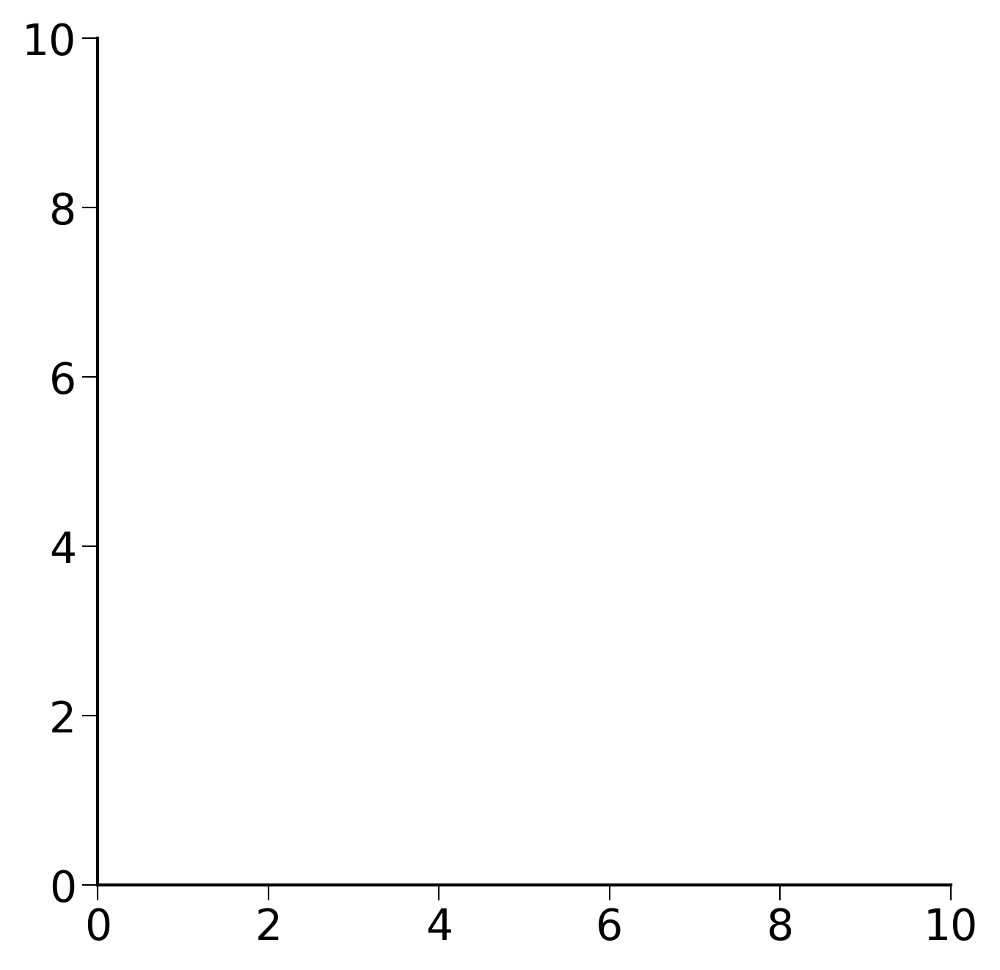

In [12]:
import scanpy as sc
import numpy as np
import operator
import pandas as pd
import torch.nn.functional as F
import torch.nn as nn
import scanpy as sc
import matplotlib.pyplot as plt
import torch
import os
from torch.nn import DataParallel
import os
import anndata as ad
import cospar as cs
import scanpy as sc
def createFig(figsize=(8, 4)):
    fig,ax=plt.subplots()           
    ax.spines['right'].set_color('none')     
    ax.spines['top'].set_color('none')
    #ax.spines['bottom'].set_color('none')     
    #ax.spines['left'].set_color('none')
    for line in ax.yaxis.get_ticklines():
        line.set_markersize(5)
        line.set_color("#585958")
        line.set_markeredgewidth(0.5)
    for line in ax.xaxis.get_ticklines():
        line.set_markersize(5)
        line.set_markeredgewidth(0.5)
        line.set_color("#585958")
    ax.set_xbound(0,10)
    ax.set_ybound(0,10)
    fig.set_size_inches(figsize)
    return fig,ax
def setPltLinewidth(linewidth:float):
    mpl.rcParams['axes.linewidth'] = linewidth
import matplotlib as mpl
fig,ax=createFig()
fig.set_size_inches(5,5)
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams['ps.fonttype'] = 42
setPltLinewidth(1)
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300
plt.rcParams['font.size'] = 14
plt.rcParams['axes.linewidth'] = 1
##setting draw parameters

In [35]:

adata.obsm['X_clone']

<49116x5864 sparse matrix of type '<class 'numpy.bool_'>'
	with 49116 stored elements in Compressed Sparse Row format>

In [13]:
def ScanpyVolcanoPlot(adata, axis, use_adjusted_p=True, show_label=True, label_fold_change=2, label_log_p=80, add_grid=True, label_size=4, filter_labels=None, kept_labels=None, color1='#F09D30', color2='#3D5FA6', label_excludes=None):
    fig, ax = createFig()
    log2foldchanges = list(map(lambda x: x[axis], adata.uns['rank_genes_groups']['logfoldchanges']))
    if use_adjusted_p:
        log10adjp = -np.log10(list(map(lambda x: x[axis], adata.uns['rank_genes_groups']['pvals_adj'])))
    else:
        log10adjp = -np.log10(list(map(lambda x: x[axis], adata.uns['rank_genes_groups']['pvals'])))
    
    ax.scatter(
        x=log2foldchanges,
        y=log10adjp,
        s=12,
        alpha=0.8,
        linewidth=0,
        c=list(map(lambda x: color2 if abs(x[0]) > label_fold_change and x[1] > label_log_p and x[0] < 0
                   else color1 if abs(x[0]) > label_fold_change and x[1] > label_log_p and x[0] > 0
                   else 'gray', zip(log2foldchanges, log10adjp)))
    )
    if add_grid:
        ax.axvline(-label_fold_change, color ="black", alpha = 0.8, lw = 0.8, ls='--')
        ax.axvline(label_fold_change, color ="black", alpha = 0.8, lw = 0.8, ls='--')
        ax.axhline(label_log_p, color ="black", alpha = 0.8, lw = 0.8, ls='--')
        ax.grid(alpha=0.4)
    if show_label:
        indices = list(map(lambda x: abs(x[0]) > label_fold_change and x[1] > label_log_p, zip(log2foldchanges, log10adjp)))
        for i, j, s in zip(np.array(log2foldchanges)[indices], np.array(log10adjp)[indices], list(map(lambda x: x[1], adata.uns['rank_genes_groups']['names'][indices]))):
            if label_excludes is not None and s in label_excludes:
                continue
            if filter_labels is not None and s in filter_labels:
                continue
            if kept_labels is not None and s not in kept_labels:
                continue
            ax.text(i, j, s=s, size=label_size)
    
    return fig, ax


In [26]:
adata=cs.hf.read("./2.2_weinreb_forziwei.h5ad")
import pickle
f_read = open('./dic_fate_weinreb_ourmodel_allundiff.pkl', 'rb')
a = pickle.load(f_read)
f_read = open('./dic_true_weinreb.pkl', 'rb')
b = pickle.load(f_read)
adata.obs['fate_pred']=None
adata.obs['fate_pred']=adata.obs['index'].map(a)
adata.obs['GT']=None
adata.obs['GT']=adata.obs['index'].map(b)

In [36]:
f_read = open('/home/zhengtuo/songtao/DestinyNet/weinreb_2.22_fate_and_prob/dic_fate_weinreb_ourmodel.pkl', 'rb')
a = pickle.load(f_read)
adata.obs['fate_pred']=None
adata.obs['fate_pred']=adata.obs['index'].map(a)

In [38]:
adata.obs['GT'].value_counts()#0: 1633, 1: 1761, 2: 271

1.0    1761
0.0    1633
2.0     271
Name: GT, dtype: int64

In [21]:
adata[adata.obs['time_info'].isin([2,4])].obs['state_info'].value_counts()

undiff        11717
Neutrophil     2831
Monocyte       2571
Baso           1545
Meg             310
Mast            283
Lymphoid        115
Erythroid        83
Eos              36
pDC              32
Ccr7_DC          24
Name: state_info, dtype: int64

In [5]:
weinreb_adata_raw = sc.read_h5ad("/home/zhengtuo/songtao/DestinyNet/weinreb.h5ad")
sc.pp.log1p(weinreb_adata_raw)
adata.raw = weinreb_adata_raw

In [6]:
adata.obsm["X_tsne"] = sc.read_h5ad("/home/zhengtuo/songtao/DestinyNet/1.8_weinreb_forziwei.h5ad").obsm["X_emb_old"]


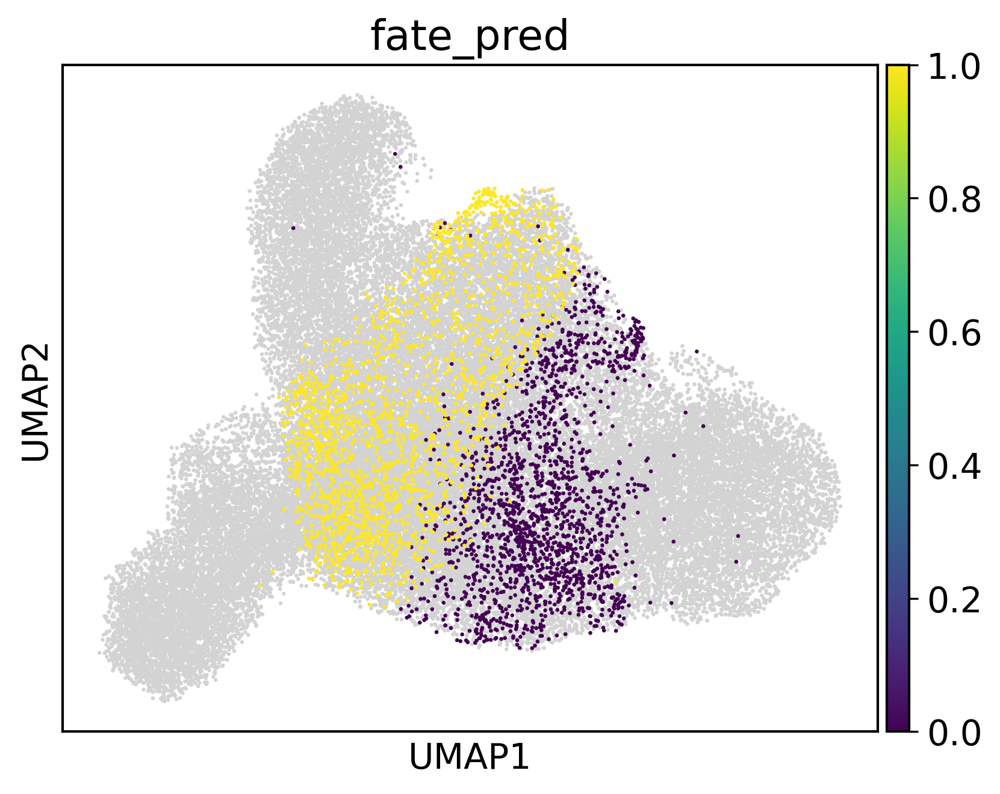

In [7]:
sc.pl.umap(adata,color='fate_pred',s=10)


In [15]:
###### from torch.utils.data import Dataset, DataLoader
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import random
from math import sqrt
from random import choice
from torch.utils.data  import Dataset, DataLoader
import pandas as pd
#from layers import SinkhornDistance
num_relations=8
len_geneExp=25289
len_embedding=256
learning_rate=0.0001
num_epoch=50
batchsize=512

criterion_rec = nn.MSELoss()
geneEnc=nn.Sequential(
        nn.Dropout(),
        nn.Linear(len_geneExp, 100),
        nn.ReLU(),
                nn.Linear(100, 100),
                nn.ReLU(),
         nn.Linear(100, 100),
                nn.ReLU(),
        nn.Linear(100, 100),
                nn.ReLU(),
        nn.Linear(100, len_embedding),
    )
    
geneDec = nn.Sequential(
    nn.Linear(len_embedding, len_geneExp),
    #nn.Linear(512, len_geneExp),
)
genemap = nn.Sequential(
     #nn.Dropout(),
     nn.Linear(len_embedding, 100),
     nn.BatchNorm1d(100),
    nn.ReLU(),
    nn.Linear(100, 100),
    nn.BatchNorm1d(100),
    nn.ReLU(),
    nn.Linear(100, 100),
    nn.BatchNorm1d(100),
    nn.ReLU(),
    nn.Linear(100, 100),
    nn.BatchNorm1d(100),
    nn.ReLU(),
    nn.Linear(100, len_embedding),

)
class SELayer(nn.Module):
    def __init__(self, channel, reduction=16):
        super(SELayer, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool1d(1)
        self.fc = nn.Sequential(
            nn.Linear(channel, channel // reduction, bias=False),
            nn.LeakyReLU(inplace=False),
            nn.Linear(channel // reduction, channel, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        b, c, _ = x.size()
        #print('channel:',c)
        #print('size:',x.shape)
        y = self.avg_pool(x).view(b, c)
        y = self.fc(y).view(b, c, 1)
        #print('y_size:',y.shape)
        return x * y.expand_as(x)
class MutiheadAttention(nn.Module):
    def __init__(self, input_dim, dim_k, dim_v,num_heads):
        super(MutiheadAttention, self).__init__()
        self.dim_q = dim_k 
        self.dim_k = dim_k
        self.dim_v = dim_v
        self.num_units=dim_k
        self.num_heads=num_heads
        self.linear_q = nn.Linear(input_dim, dim_k, bias=False)
        self.linear_k = nn.Linear(input_dim, dim_k, bias=False)
        self.linear_v = nn.Linear(input_dim, dim_v, bias=False)
        self._norm_fact = 1 / sqrt(dim_k)

    def forward(self, x):
        # x: batch_size, seq_len, input_dim
        q = self.linear_q(x)  # batch_size, seq_len, dim_k
        k = self.linear_k(x)  # batch_size, seq_len, dim_k
        v = self.linear_v(x)  # batch_size, seq_len, dim_v
        split_size = self.num_units // self.num_heads
        q = torch.stack(torch.split(q, split_size, dim=2), dim=0)  # [h, N, T_q, num_units/h]
        k = torch.stack(torch.split(k, split_size, dim=2), dim=0)  # [h, N, T_k, num_units/h]
        v = torch.stack(torch.split(v, split_size, dim=2), dim=0)  # [h, N, T_k, num_units/h]

        scores = torch.matmul(q, k.transpose(2, 3))
        scores = scores / (self.dim_k ** 0.5)
        
        scores = F.softmax(scores, dim=3)
        ## out = score * V
        out = torch.matmul(scores, v)  # [h, N, T_q, num_units/h]
        out = torch.cat(torch.split(out, 1, dim=0), dim=3).squeeze(0) 

        return out

class ResidualBlock(torch.nn.Module):
    def __init__(self,channels):
        super(ResidualBlock,self).__init__()
        self.channels = channels
        self.conv1 = nn.Conv1d(channels,channels,kernel_size=3,padding=1)
        self.conv2 = nn.Conv1d(channels,channels,kernel_size=3,padding=1)
        self.se=SELayer(channels,16)
    def forward(self, x):
        y = F.relu(self.conv1(x))
        y = self.conv2(y)
        y=self.se(y)
        return F.relu(x+y)

class DestinyNet(nn.Module):
    def __init__(self):
        nn.Module.__init__(self)
        self.att=MutiheadAttention(len_embedding*2,512,512,64)
        self.layernorm=nn.LayerNorm(512)
        self.conv1 = nn.Conv1d(1, 32, 4)  
        self.relu1=nn.LeakyReLU(0.2, inplace=True)
        self.rblock1 = ResidualBlock(32)
        self.conv2 = nn.Conv1d(32,64, 4)  
        self.batchn1=nn.BatchNorm1d(64)
        self.relu2= nn.LeakyReLU(0.2, inplace=True)
        self.rblock2 = ResidualBlock(64)
        self.conv3=nn.Conv1d(64,128,4)
        self.batchn2=nn.BatchNorm1d(128)
        self.relu3= nn.LeakyReLU(0.2, inplace=True)
        self.rblock3 = ResidualBlock(128)
        self.conv4=nn.Conv1d(128,256,4)
        self.batchn3=nn.BatchNorm1d(256)
        self.relu4= nn.LeakyReLU(0.2, inplace=True)
        self.rblock4 = ResidualBlock(256)
        self.dropout=nn.Dropout()
        self.fc1 = nn.Linear(7424, num_relations)
        
    def forward(self, x):
        x=self.att(x)+x
        x=self.layernorm(x)
        x = self.conv1(x)
        x = self.relu1(x)
        x = F.max_pool1d(x, 2)
        x=self.rblock1(x)
        x = self.conv2(x)
        x=self.batchn1(x)
        x=self.relu2(x)
        x = F.max_pool1d(x, 2)
        x=self.rblock2(x)
        
        x = self.conv3(x)
        x=self.batchn2(x)
        x=self.relu3(x)
        x = F.max_pool1d(x, 2)
        x=self.rblock3(x)
        
        x = self.conv4(x)
        x=self.batchn3(x)
        x=self.relu4(x)
        x = F.max_pool1d(x, 2)
        x=self.rblock4(x)
        x = x.view(x.size()[0], -1)
        x=self.dropout(x)
        x=self.fc1(x)
        return x
class TrainDataset(Dataset):
    def __init__(self,length):
        self.length=length

    def __getitem__(self, idx):
        cell1_id=int(traincell1[idx])
        cell2_id=int(traincell2[idx])
        gene1=adata_orig.X[cell1_id]
        gene1=torch.tensor(gene1)
        gene2=adata_orig.X[cell2_id]
        gene2=torch.tensor(gene2)       
        genetype=train_rel[idx]
        #genetype=dic1[genetype]
        genetype=torch.tensor(genetype)
        return gene1,gene2,genetype

    def __len__(self):
        return self.length
model=DestinyNet()
optimizer = torch.optim.Adam(
    [{'params': geneEnc.parameters()},
    {'params': model.parameters()},
        {'params': geneDec.parameters()},
    #{'params': norelmodel.parameters()},
            {'params': genemap.parameters()}],
    lr=learning_rate)
from sklearn.metrics import confusion_matrix
TwoNets_path='/home/zhengtuo/songtao/weinreb.pth'
checkpoint = torch.load(TwoNets_path,map_location='cuda:1')
device2=torch.device("cuda:1")
device=torch.device("cuda:1")

model.load_state_dict(checkpoint['model'])
model.to(device2)
geneEnc.load_state_dict(checkpoint['geneEnc'])
geneEnc.to(device2)
geneDec.load_state_dict(checkpoint['geneDec'])
geneDec.to(device2)

model.eval()
geneEnc.eval()
geneDec.eval()

genemap.load_state_dict(checkpoint['genemap'])
genemap.to(device2)
genemap.eval()



Sequential(
  (0): Linear(in_features=256, out_features=100, bias=True)
  (1): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (2): ReLU()
  (3): Linear(in_features=100, out_features=100, bias=True)
  (4): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (5): ReLU()
  (6): Linear(in_features=100, out_features=100, bias=True)
  (7): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (8): ReLU()
  (9): Linear(in_features=100, out_features=100, bias=True)
  (10): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (11): ReLU()
  (12): Linear(in_features=100, out_features=256, bias=True)
)

100%|█████████████████████████████████████| 49116/49116 [28:23<00:00, 28.83it/s]


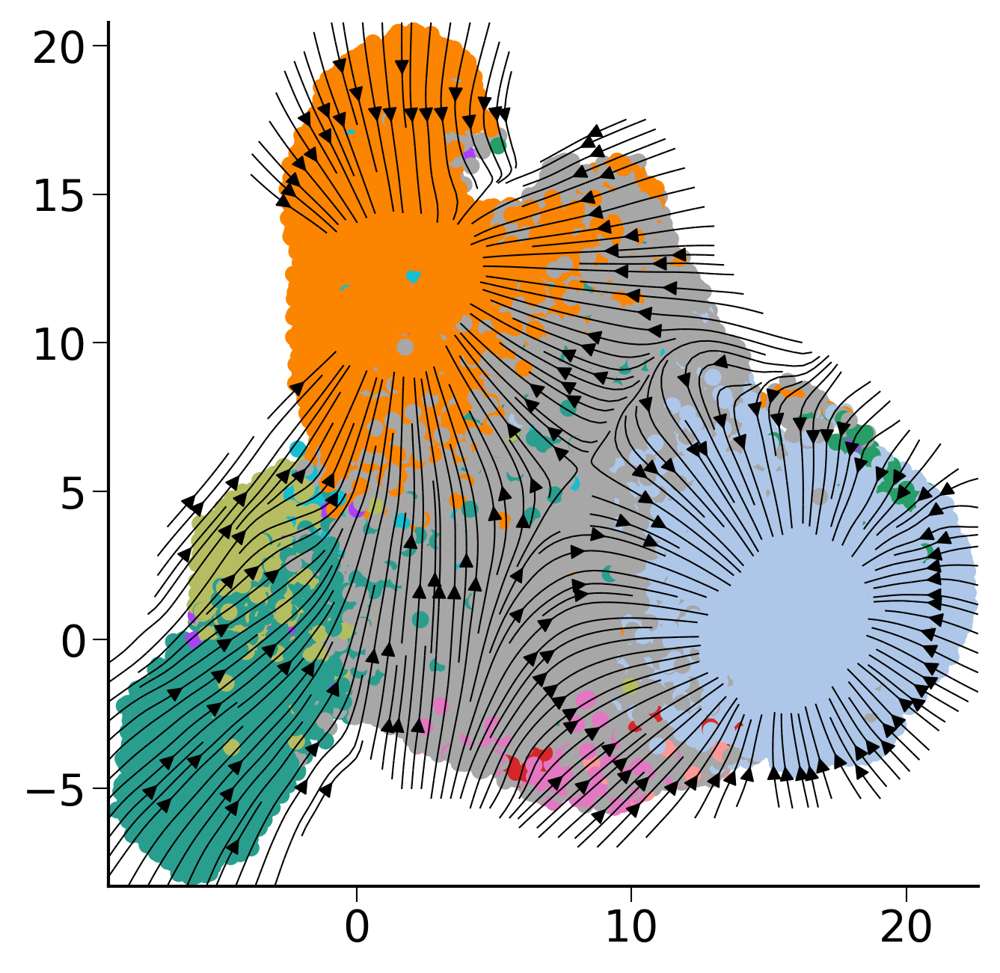

In [21]:
def compute_velocity_on_grid(
    X_emb,
    M_emb,
    density=None,
    smooth=None,
    n_neighbors=None,
    min_mass=None,
    autoscale=True,
    adjust_for_stream=False,
    cutoff_perc=None,
):
    # remove invalid cells
    idx_valid = np.isfinite(X_emb.sum(1) + M_emb.sum(1))
    X_emb = X_emb[idx_valid]
    M_emb = M_emb[idx_valid]

    # prepare grid
    n_obs, n_dim = X_emb.shape
    density = 0.5 if density is None else density
    smooth = 0.5 if smooth is None else smooth

    grs = []
    for dim_i in range(n_dim):
        m, M = np.min(X_emb[:, dim_i]), np.max(X_emb[:, dim_i])
        m = m - 0.01 * np.abs(M - m)
        M = M + 0.01 * np.abs(M - m)
        gr = np.linspace(m, M, int(50 * density))
        grs.append(gr)

    meshes_tuple = np.meshgrid(*grs)
    X_grid = np.vstack([i.flat for i in meshes_tuple]).T

    # estimate grid velocities
    if n_neighbors is None:
        n_neighbors = int(n_obs / 50)
    nn = NearestNeighbors(n_neighbors=n_neighbors, n_jobs=-1)
    nn.fit(X_emb)
    dists, neighs = nn.kneighbors(X_grid)

    scale = np.mean([(g[1] - g[0]) for g in grs]) * smooth
    weight = normal.pdf(x=dists, scale=scale)
    p_mass = weight.sum(1)

    V_grid = (M_emb[neighs] * weight[:, :, None]).sum(1)
    V_grid /= np.maximum(1, p_mass)[:, None]
    if min_mass is None:
        min_mass = 1

    if adjust_for_stream:
        X_grid = np.stack([np.unique(X_grid[:, 0]), np.unique(X_grid[:, 1])])
        ns = int(np.sqrt(len(V_grid[:, 0])))
        V_grid = V_grid.T.reshape(2, ns, ns)

        mass = np.sqrt((V_grid ** 2).sum(0))
        min_mass = 10 ** (min_mass - 6)  # default min_mass = 1e-5
        min_mass = np.clip(min_mass, None, np.max(mass) * 0.9)
        cutoff = mass.reshape(V_grid[0].shape) < min_mass

        if cutoff_perc is None:
            cutoff_perc = 5
        length = np.sum(np.mean(np.abs(M_emb[neighs]), axis=1), axis=1).T
        length = length.reshape(ns, ns)
        cutoff |= length < np.percentile(length, cutoff_perc)

        V_grid[0][cutoff] = np.nan
    else:
        min_mass *= np.percentile(p_mass, 99) / 100
        X_grid, V_grid = X_grid[p_mass > min_mass], V_grid[p_mass > min_mass]

        if autoscale:
            V_grid /= 3 * quiver_autoscale(X_grid, V_grid)

    return X_grid, V_grid

def quiver_autoscale(X_emb, V_emb):
    import matplotlib.pyplot as pl

    scale_factor = np.abs(X_emb).max()  # just so that it handles very large values
    fig, ax = pl.subplots()
    Q = ax.quiver(
        X_emb[:, 0] / scale_factor,
        X_emb[:, 1] / scale_factor,
        V_emb[:, 0],
        V_emb[:, 1],
        angles="xy",
        scale_units="xy",
        scale=None,
    )
    Q._init()
    fig.clf()
    pl.close(fig)
    return Q.scale / scale_factor
import numpy as np
from scipy.stats import norm as normal
from sklearn.neighbors import NearestNeighbors
import tqdm
sc.pp.neighbors(adata)

X = adata.obsm['geneEnc'][:,0,:]
M = adata.obsm['genemap'][:,0,:]
N = adata.obsp['connectivities']
E = adata.obsm["X_umap"]
norm = lambda x: (x-min(x))/(max(x)-min(x))
nn = NearestNeighbors(n_neighbors=20)
nn.fit(X)
dE = []
for i in tqdm.trange(N.shape[0]):

    D,I = nn.kneighbors( np.array([M[i]]) )
    dE.append( (E[I][0] - E[i]).mean(0))
dE = np.vstack(dE)
gE, gdE = compute_velocity_on_grid(E,dE,density=2, adjust_for_stream=True,smooth=True)
fig,ax=createFig()
fig.set_size_inches(5,5)
palette = sc.pl._tools.scatterplots._get_palette(adata, 'state_info')
ax.scatter(E[:,0],E[:,1],s=30, linewidths=0,c=list(map(lambda x: palette[x], adata.obs['state_info'])))
stream_kwargs = {
        "linewidth": 0.5,
        "density": 3,
        "zorder": 3,
        "color": "black",
        "arrowsize":  1,
    
        "arrowstyle": "-|>",
        "maxlength":  10,
        "integration_direction":  "both",
}
ax.streamplot(gE[0],gE[1],gdE[0],gdE[1],**stream_kwargs)


/home/zhengtuo/miniconda3/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


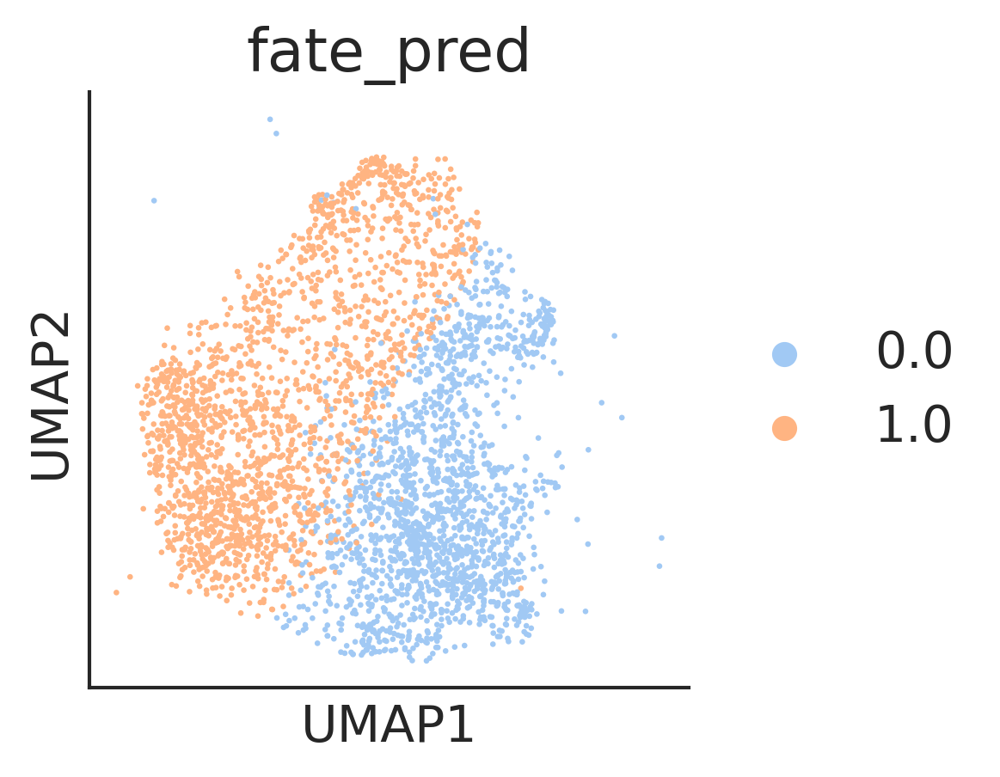

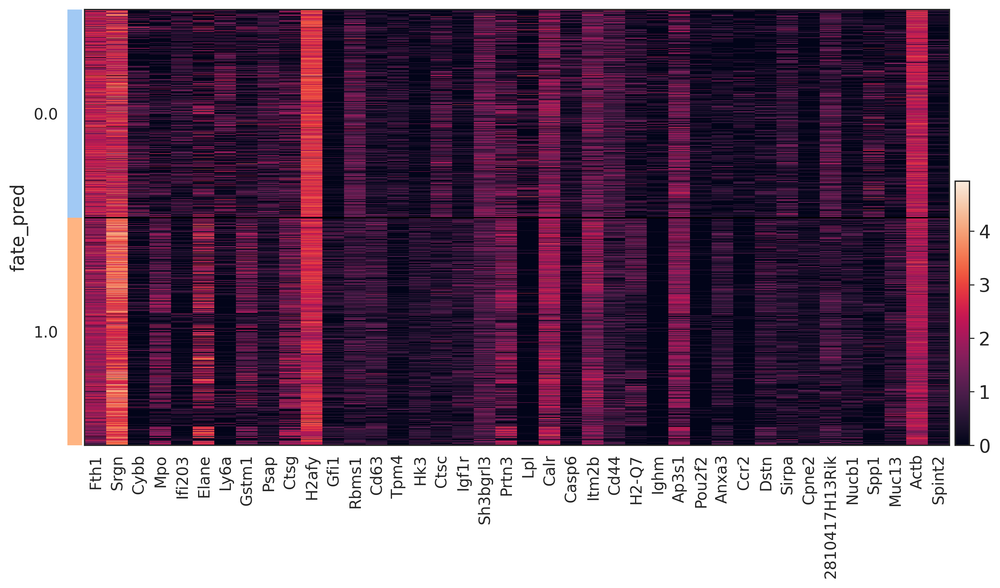

In [93]:
adata3=adata[adata.obs['fate_pred'].isin([0,1])].copy()
adata3.obs['fate_pred'] = adata3.obs['fate_pred'].astype('category')

from sklearn.neighbors import KNeighborsClassifier
plt.rcParams['font.size'] = 14
fig,ax=createFig(figsize=(3,3))
sc.pl.umap(adata3,color=['fate_pred'],ax=ax,s=10)
sc.tl.rank_genes_groups(adata3, groupby='fate_pred', method='wilcoxon')
sc.pl.heatmap(
    adata3,
    pd.DataFrame(adata3.uns['rank_genes_groups']['names']).head(20).to_numpy().flatten(), 
    groupby='fate_pred'#,log=True, cmap='Reds'
)

In [95]:
#adata3.uns
pd.DataFrame(adata3.uns['rank_genes_groups']['logfoldchanges'].head(20),
             adata3.uns['rank_genes_groups']['names'].head(20))

In [70]:
f_read = open('./dic_fate_weinreb_ourmodel_allundiff.pkl', 'rb')
#f_read = open('/home/zhengtuo/songtao/DestinyNet/weinreb_2.22_fate_and_prob/dic_fate_weinreb_ourmodel.pkl', 'rb')
a = pickle.load(f_read)
adata.obs['fate_pred']=None
adata.obs['fate_pred']=adata.obs['index'].map(a)
adata3=adata[adata.obs['fate_pred'].isin([0,1])].copy()
adata3.obs['fate_pred'] = adata3.obs['fate_pred'].astype('category')
sc.tl.rank_genes_groups(adata3, groupby='fate_pred', method='wilcoxon',use_raw=True)
# fig, ax = ScanpyVolcanoPlot(adata3, axis=1,
#                            label_fold_change=1,label_log_p=2,
#                            label_size=8,show_label=True,label_includes=['Elane'])
# ax.set_xbound(-5,5)
# fig.set_size_inches(5,5)



In [129]:
adata3=adata[adata.obs['GT'].isin([0,1])].copy()
adata3.obs['GT']=adata3.obs['GT'].astype(str)
sc.tl.rank_genes_groups(adata3, groupby='GT', method='wilcoxon')
# fig, ax = ScanpyVolcanoPlot(adata3, axis=1,
#                            label_fold_change=1,label_log_p=2,
#                            label_size=8,show_label=True,label_includes=['Gata2'])
# ax.set_xbound(-5,5)
# fig.set_size_inches(5,5)

... storing 'GT' as categorical


In [81]:

logFC_threshold = 1
adj_pval_threshold = 0.05
result_dict = adata3.uns['rank_genes_groups']
groups = result_dict['names'].dtype.names
markers_list = []
for group in groups:
    markers_df = pd.DataFrame(
        {
            'names': result_dict['names'][group],
            'scores': result_dict['scores'][group],
            'logfoldchanges': result_dict['logfoldchanges'][group],
            'pvals': result_dict['pvals'][group],
            'pvals_adj': result_dict['pvals_adj'][group],                
            'group': group,
        }
    )
 # Filter the table by log fold change and adjusted p-value thresholds
    filtered_markers_df = markers_df[(markers_df['logfoldchanges'] > 1) & (markers_df['pvals_adj'] < adj_pval_threshold)]
    markers_list.append(filtered_markers_df)

all_markers_df = pd.concat(markers_list, axis=0)

all_markers_df.to_csv(f'/home/zhengtuo/songtao/marker_allundiff_pred_9.15.csv', index=False)
#all_markers_df.to_csv(f'/home/songtaojiang/deng/peaks_marker_withpeaks.csv', index=False)


In [77]:
len(all_markers_df)

264

In [719]:
df_GT_pred=all_markers_df
df_GT_pred_group = df_GT_pred[df_GT_pred['group'] == '1.0']

genes_GT_pred = set(df_GT_pred_group['names'])
print(len(genes_GT_pred))

700


In [95]:
import pandas as pd
from matplotlib_venn import venn3
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages

df_GT_pred = pd.read_csv('/home/zhengtuo/songtao/marker_GT_pred.csv')
df_allundiff_pred = pd.read_csv('/home/zhengtuo/songtao/marker_allundiff_pred.csv')
df_GT_groundtruth = pd.read_csv('/home/zhengtuo/songtao/marker_GT_groundtruth.csv')

with PdfPages('./Venn3_weinreb.pdf') as pdf:
    for group in df_GT_pred['group'].unique():
        df_GT_pred_group = df_GT_pred[df_GT_pred['group'] == group]
        df_allundiff_pred_group = df_allundiff_pred[df_allundiff_pred['group'] == group]
        df_GT_groundtruth_group = df_GT_groundtruth[df_GT_groundtruth['group'] == group]

        genes_GT_pred = set(df_GT_pred_group['names'])
        genes_allundiff_pred = set(df_allundiff_pred_group['names'])
        genes_GT_groundtruth = set(df_GT_groundtruth_group['names'])
        print(len(genes_GT_pred))
        print(len(genes_allundiff_pred))
        print(len(genes_GT_groundtruth))
        overlap_GT_pred_allundiff = genes_GT_pred.intersection(genes_allundiff_pred)
        overlap_GT_pred_groundtruth = genes_GT_pred.intersection(genes_GT_groundtruth)
        overlap_allundiff_groundtruth = genes_allundiff_pred.intersection(genes_GT_groundtruth)

        fig, ax = plt.subplots()
        venn3([genes_GT_pred, genes_allundiff_pred, genes_GT_groundtruth], ('GT_pred', 'allundiff_pred', 'GT_groundtruth'), ax=ax)
        ax.set_title(f'Overlap among GT_pred, allundiff_pred and GT_groundtruth for group {group}')
        
        pdf.savefig(fig, bbox_inches='tight')
        plt.close(fig)


78
109
75
85
90
70


In [680]:
df_GT_pred[df_GT_pred['group'] == 0.0]

,names,scores,logfoldchanges,pvals,pvals_adj,group
0,Fth1,20.916939,0.655497,3.754473e-97,1.898938e-93,0.0
1,Cybb,16.727560,2.075559,8.255037e-63,2.087616e-59,0.0
2,Ifi203,16.475517,1.720728,5.501524e-61,1.264800e-57,0.0
3,Ly6a,16.257133,1.924848,1.988261e-59,3.867780e-56,0.0
4,Psap,15.400703,1.177309,1.618987e-53,2.732804e-50,0.0
...,...,...,...,...,...,...
241,Ywhab,3.156941,0.169605,1.594336e-03,4.354121e-02,0.0
242,Cse1l,3.155207,0.204191,1.603845e-03,4.370650e-02,0.0
243,1110004F10Rik,3.151378,0.190176,1.625019e-03,4.423584e-02,0.0
244,Anxa2,3.141347,0.340332,1.681729e-03,4.558332e-02,0.0


In [126]:
f_read = open('/home/zhengtuo/songtao/DestinyNet/weinreb_2.22_fate_and_prob/dic_fate_weinreb_ourmodel.pkl', 'rb')
a = pickle.load(f_read)
adata.obs['fate_pred']=None
adata.obs['fate_pred']=adata.obs['index'].map(a)
adata3=adata[adata.obs['fate_pred'].isin([0,1])].copy()
adata3.obs['fate_pred'] = adata3.obs['fate_pred'].astype('category')
sc.tl.rank_genes_groups(adata3, groupby='fate_pred', method='wilcoxon')

# fig, ax = ScanpyVolcanoPlot(adata3, axis=1,
#                            label_fold_change=1,label_log_p=2,
#                            label_size=8,show_label=True,label_includes=['Gata2'])
# ax.set_xbound(-5,5)
# fig.set_size_inches(5,5)




In [122]:
weinreb_adata_background = adata[
    list(map(lambda x: x == 'Monocyte' or x == 'Neutrophil', adata.obs['state_info'] ))
]
sc.tl.rank_genes_groups(weinreb_adata_background, groupby='state_info',method='wilcoxon')
#ScanpyVolcanoPlot(weinreb_adata_background, axis=1)

In [595]:
d = set(pd.DataFrame(adata3.uns['rank_genes_groups']['names'])['0.0'].loc[
    np.array(pd.DataFrame(adata3.uns['rank_genes_groups']['logfoldchanges'])['0.0'] > 1.5) &
    np.array(pd.DataFrame(adata3.uns['rank_genes_groups']['pvals_adj']['0.0']) < 0.05)
]).union(
set(pd.DataFrame(adata3.uns['rank_genes_groups']['names'])['1.0'].loc[
    np.array(pd.DataFrame(adata3.uns['rank_genes_groups']['logfoldchanges'])['1.0'] > 1.5) &
    np.array(pd.DataFrame(adata3.uns['rank_genes_groups']['pvals_adj']['1.0']) < 0.05)
]))

In [194]:
s = set(pd.DataFrame(weinreb_adata_background.uns['rank_genes_groups']['names']).head(200).to_numpy().flatten())


In [135]:
adata3.uns['rank_genes_groups']['pvals_adj']['1.0'][0]=1e-300

1e-300

/tmp/ipykernel_116596/210889169.py:5: RuntimeWarning: divide by zero encountered in log10
  log10adjp = -np.log10(list(map(lambda x: x[axis], adata.uns['rank_genes_groups']['pvals_adj'])))


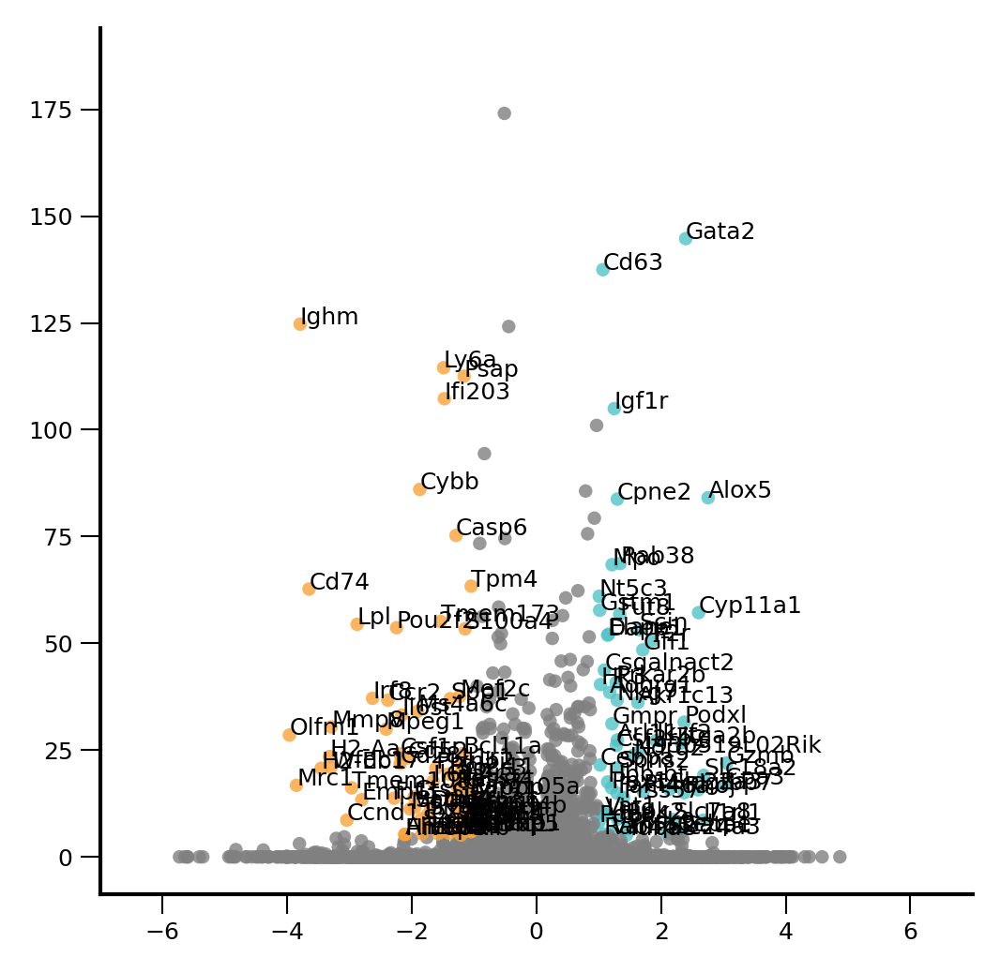

In [18]:
plt.rcParams['font.size'] = 6

fig, ax = ScanpyVolcanoPlot(
    adata3, 
    1, 
    label_log_p=5, 
    show_label=True, 
    label_fold_change=1, 
    label_size=6,
    add_grid=False,
    color1= '#50C3C6',
    color2= '#FAA339',
)

scatter = ax.collections[0]

y_values = scatter.get_offsets()[:, 1].compressed()

ymax = max(y_values) + 20

ax.set_xbound(-7,7)
ax.set_ybound(upper=ymax)
fig.set_size_inches(4,4)
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')
plt.show()
#fig.savefig("/home/zhengtuo/songtao/weinreb_allundiff_pred_includeNeuMoMarker_nowords.pdf", dpi=1000)

In [577]:
top_genes

Index(['Ctsc', 'Lpl', 'Nfkbia', 'Rbms1', 'Fth1', 'Psap', 'Ifi203', 'H2afy',
       'Ighm', 'Ly6a', 'Srgn', 'Gata2', 'Elane', 'Mpo', 'Lgals9', 'Muc13',
       'Gzmb', 'Ctsg', 'Calr', 'H2-Q7'],
      dtype='object')

In [74]:
plt.rcParams['font.size'] = 6

fig, ax = ScanpyVolcanoPlot(
    adata3, 
    1, 
    label_log_p=5, 
    show_label=True, 
    label_fold_change=0, 
    label_size=6,
    label_includes=top_genes,
    add_grid=False,
    color1= '#50C3C6',
    color2= '#FAA339',
)

ax.set_xbound(-7,7)
fig.set_size_inches(4,4)
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')

to_remove_coords = []
for text in ax.texts:
    if text.get_text() not in list(top_genes):
        x, y = text.get_position()
        to_remove_coords.append((x, y))
        text.remove()

scatter = ax.collections[0]

offsets = scatter.get_offsets()
colors = scatter.get_facecolor()

new_colors = []
new_offsets = []

for i, offset in enumerate(offsets):
    if tuple(offset) not in to_remove_coords:
        new_offsets.append(offset)
        new_colors.append(colors[i])

assert len(new_colors) == len(new_offsets)

scatter.remove()

point_size = 10  
ax.scatter(*zip(*new_offsets), c=new_colors, cmap=scatter.get_cmap(), norm=scatter.norm, s=point_size)

# 调整文字的大小
for text in ax.texts:
    text.set_fontsize(5)  

# 扩大图形大小
fig.set_size_inches(4,4)  

plt.draw()

fig.savefig("/home/zhengtuo/songtao/weinreb_GT_includeNeuMoMarker_top20withoutOthers.pdf", dpi=1000)


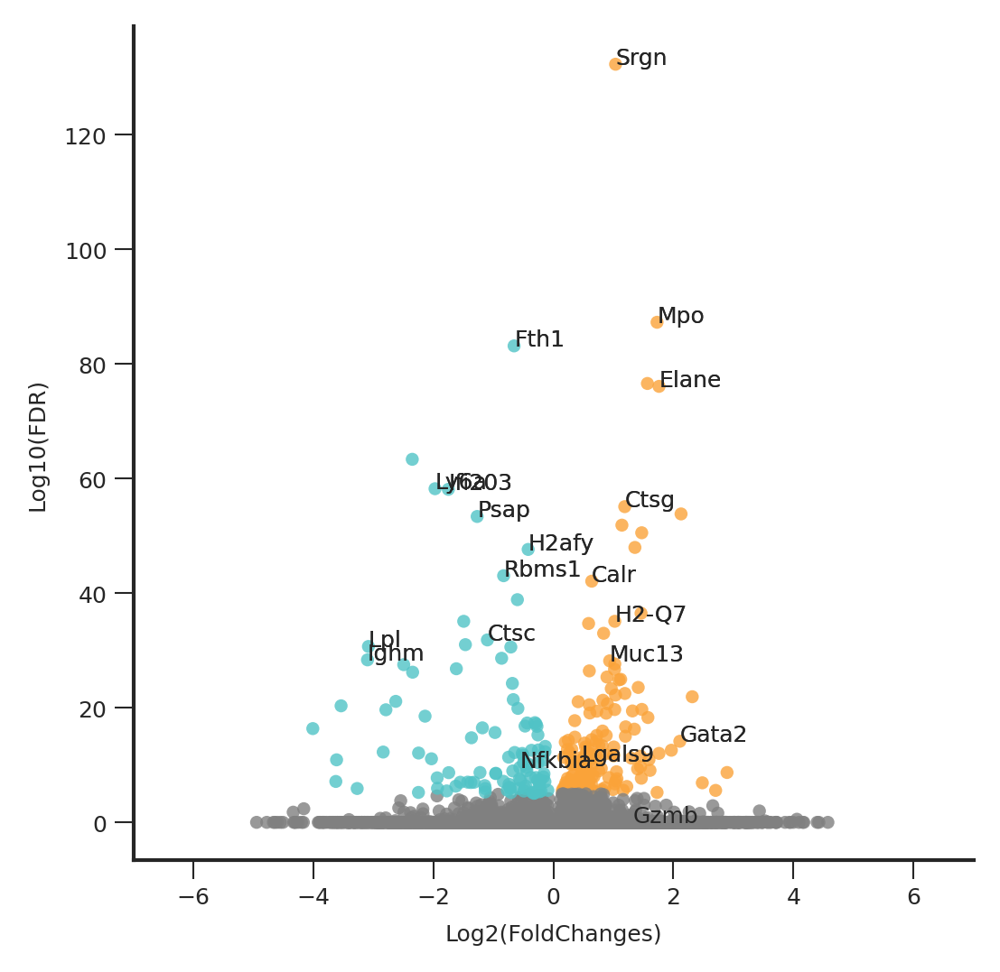

In [599]:
plt.rcParams['font.size'] = 6

fig, ax = ScanpyVolcanoPlot(
    adata3, 
    1, 
    label_log_p=5, 
    show_label=True, 
    label_fold_change=0, 
    label_size=6,
    label_includes=top_genes,
    add_grid=False,
    color1= '#50C3C6',
    color2= '#FAA339',
)

ax.set_xbound(-7,7)
fig.set_size_inches(4,4)
ax.xaxis.set_ticks_position('bottom')
ax.yaxis.set_ticks_position('left')

to_remove_coords = []
for text in ax.texts:
    if text.get_text() not in list(top_genes):
        x, y = text.get_position()
        to_remove_coords.append((x, y))
        text.remove()
plt.draw()

fig.savefig("/home/zhengtuo/songtao/weinreb_GT_includeNeuMoMarker_top20withOthers.pdf", dpi=1000)


In [874]:
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
gene_jia=['Pou2f2', 'Tmem173', 'Rab38', 'Mef2c', 'Mmp8', 'S100a9', 'Ngp']
def create_umap_for_gene(adata, gene_name):
    fig, ax = plt.subplots()
    fig.set_size_inches(5, 5)
    ax.scatter(
        adata.obsm["X_umap"][:, 0],
        adata.obsm["X_umap"][:, 1],
        s=1,
        linewidths=0,
        color='#FDF6F3'
    )
    sc.pl.umap(
        adata[adata.X[:, list(adata.var.index).index(gene_name)] > 0], ax=ax,
        color=gene_name,
        cmap='Reds',
        s=5
    )
    return fig

with PdfPages('genes_extent.pdf') as pdf:
    for gene_name in gene_jia:
        fig = create_umap_for_gene(adata, gene_name)
        pdf.savefig(fig)  
        plt.close(fig)  


In [610]:
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages

def create_umap_for_gene(adata, gene_name):
    fig, ax = plt.subplots()
    fig.set_size_inches(5, 5)
    ax.scatter(
        adata.obsm["X_umap"][:, 0],
        adata.obsm["X_umap"][:, 1],
        s=1,
        linewidths=0,
        color='#FDF6F3'
    )
    sc.pl.umap(
        adata[adata.X[:, list(adata.var.index).index(gene_name)] > 0], ax=ax,
        color=gene_name,
        cmap='Reds',
        s=5
    )
    return fig

with PdfPages('top20genes_plots.pdf') as pdf:
    for gene_name in top_genes:
        fig = create_umap_for_gene(adata, gene_name)
        pdf.savefig(fig) 
        plt.close(fig) 


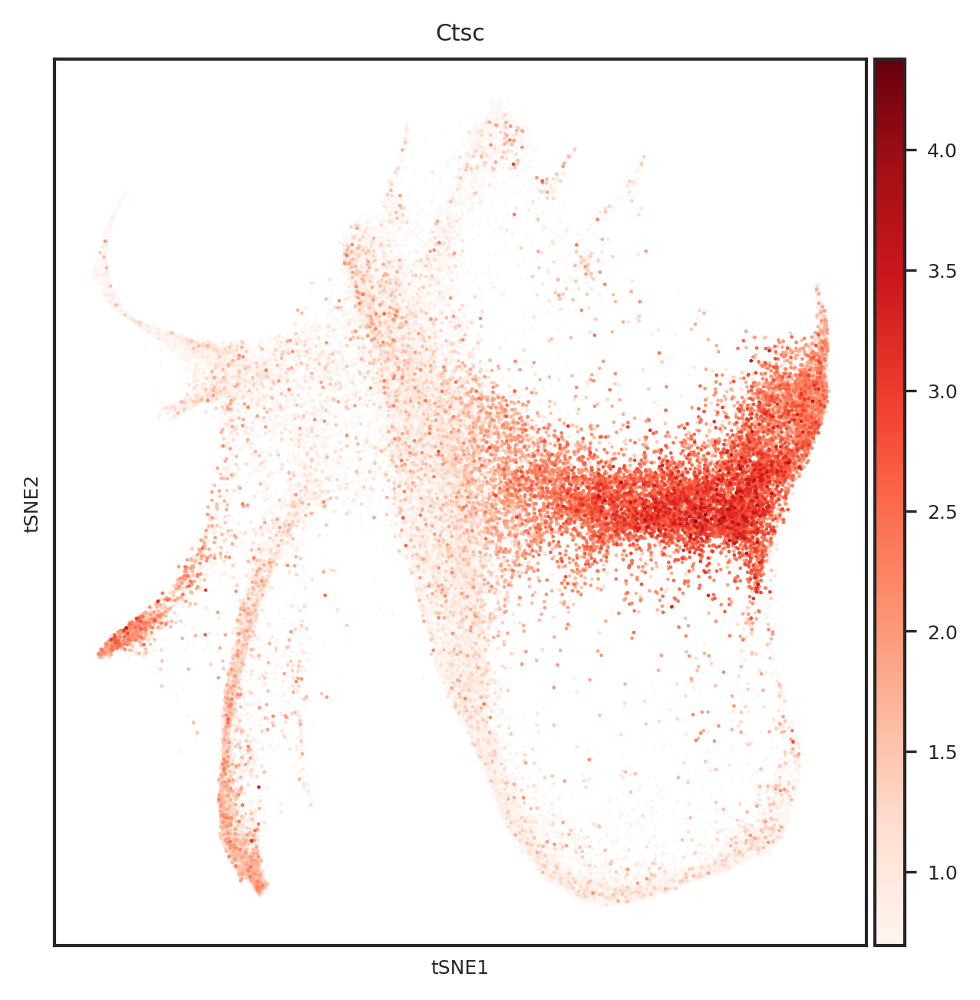

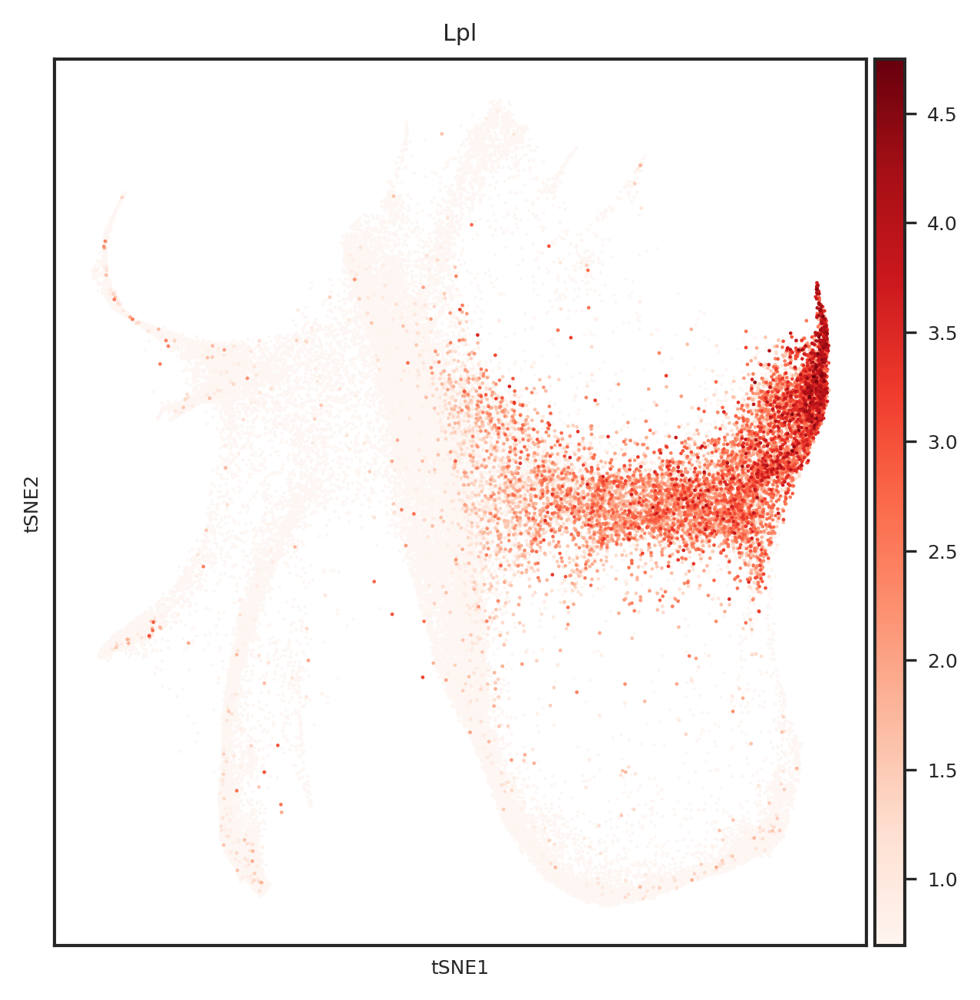

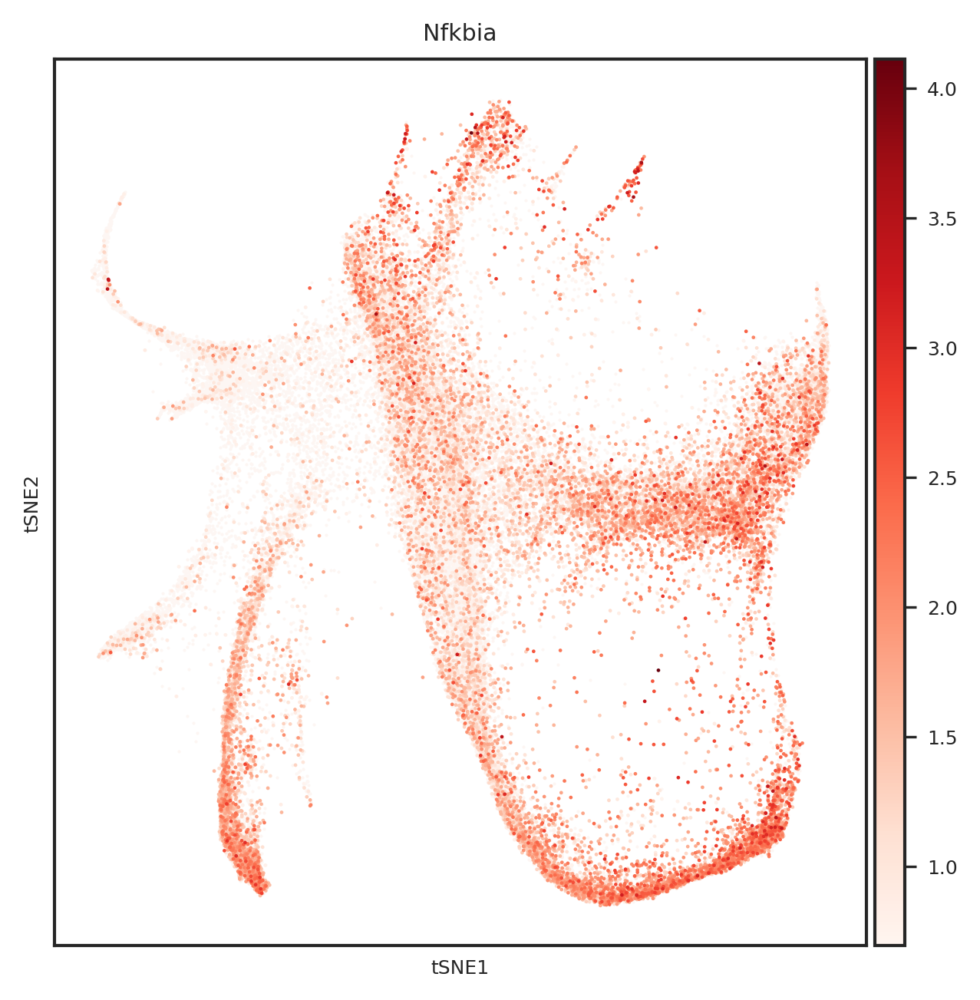

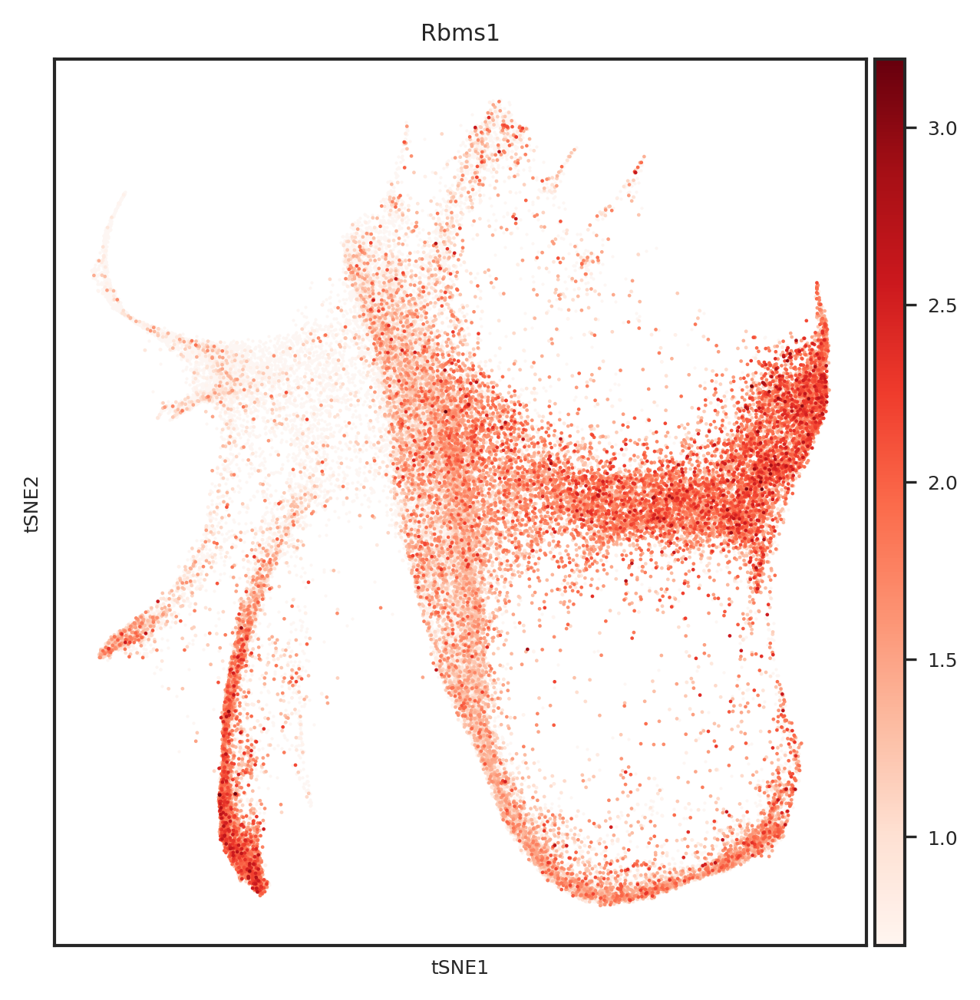

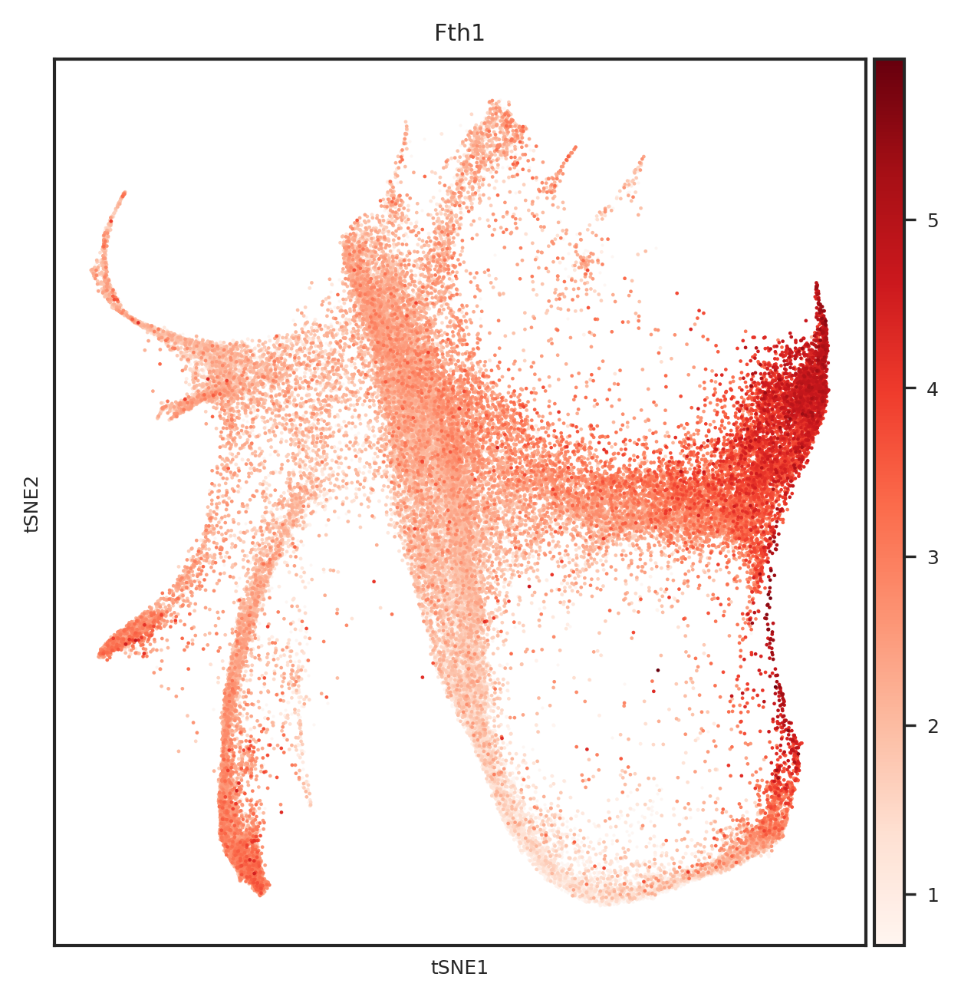

...

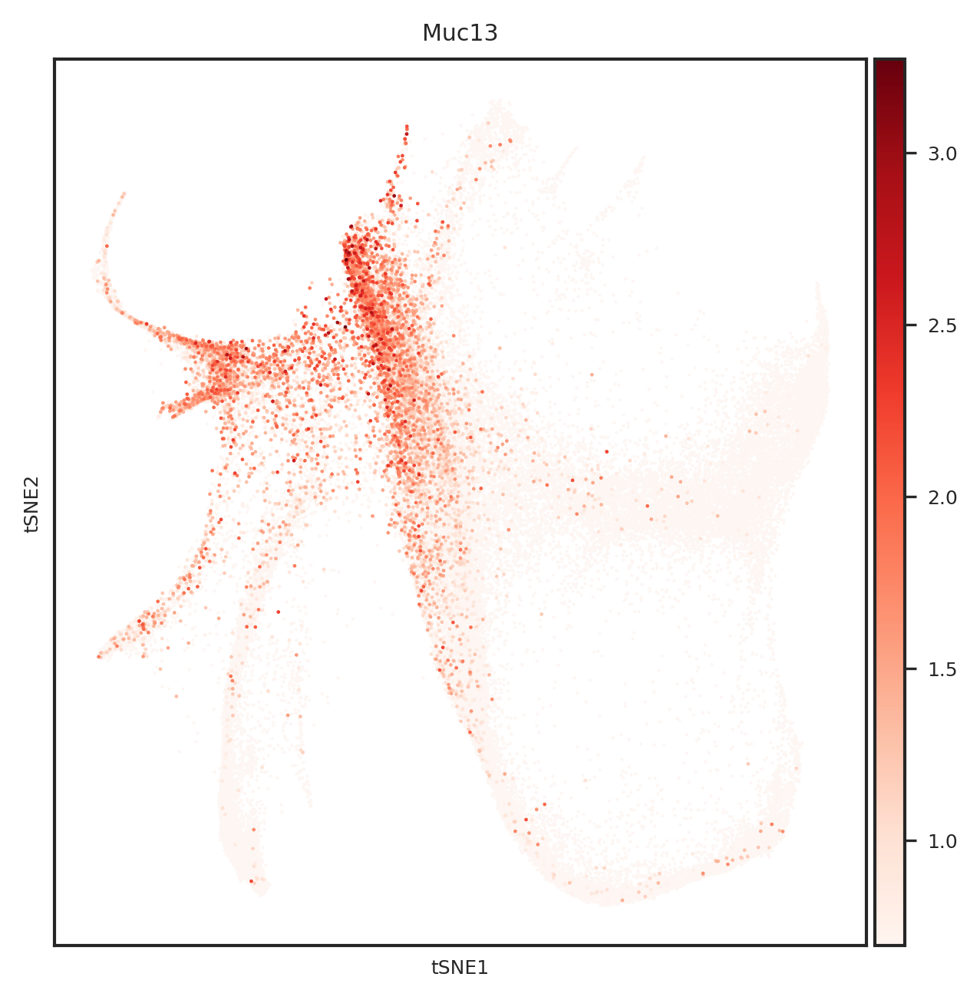

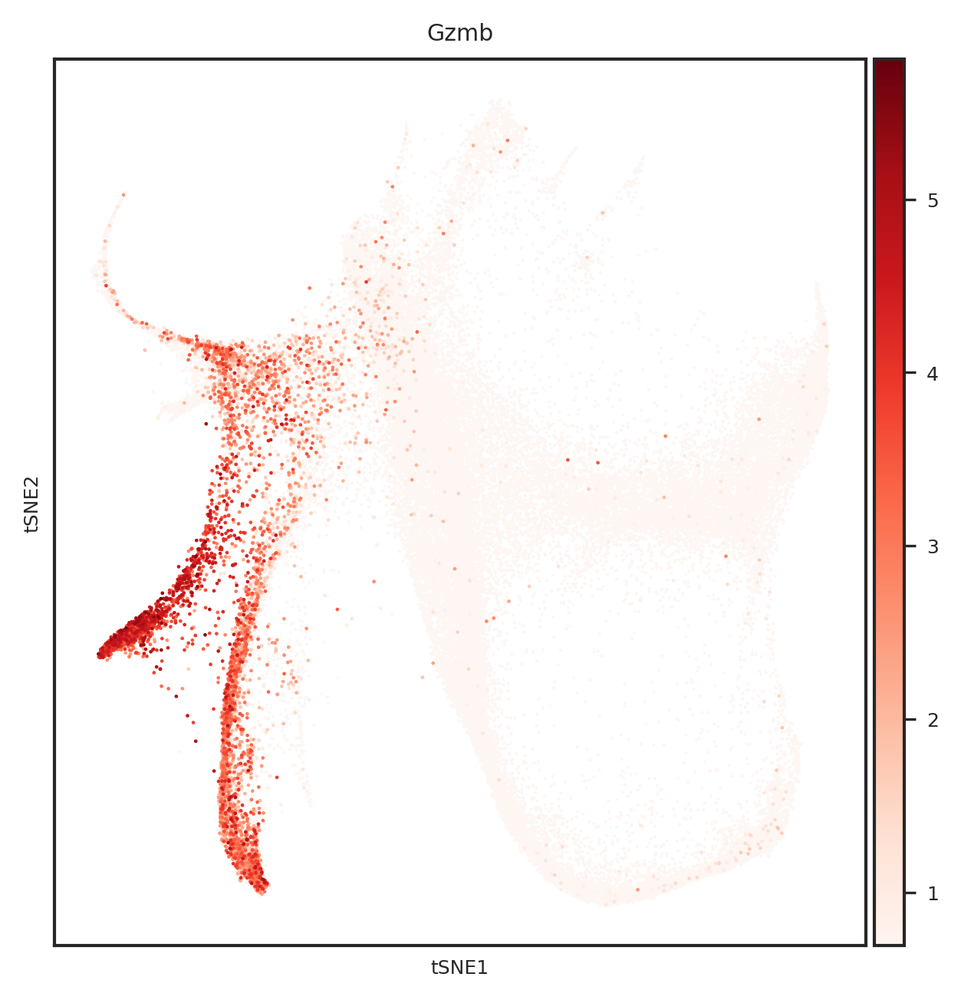

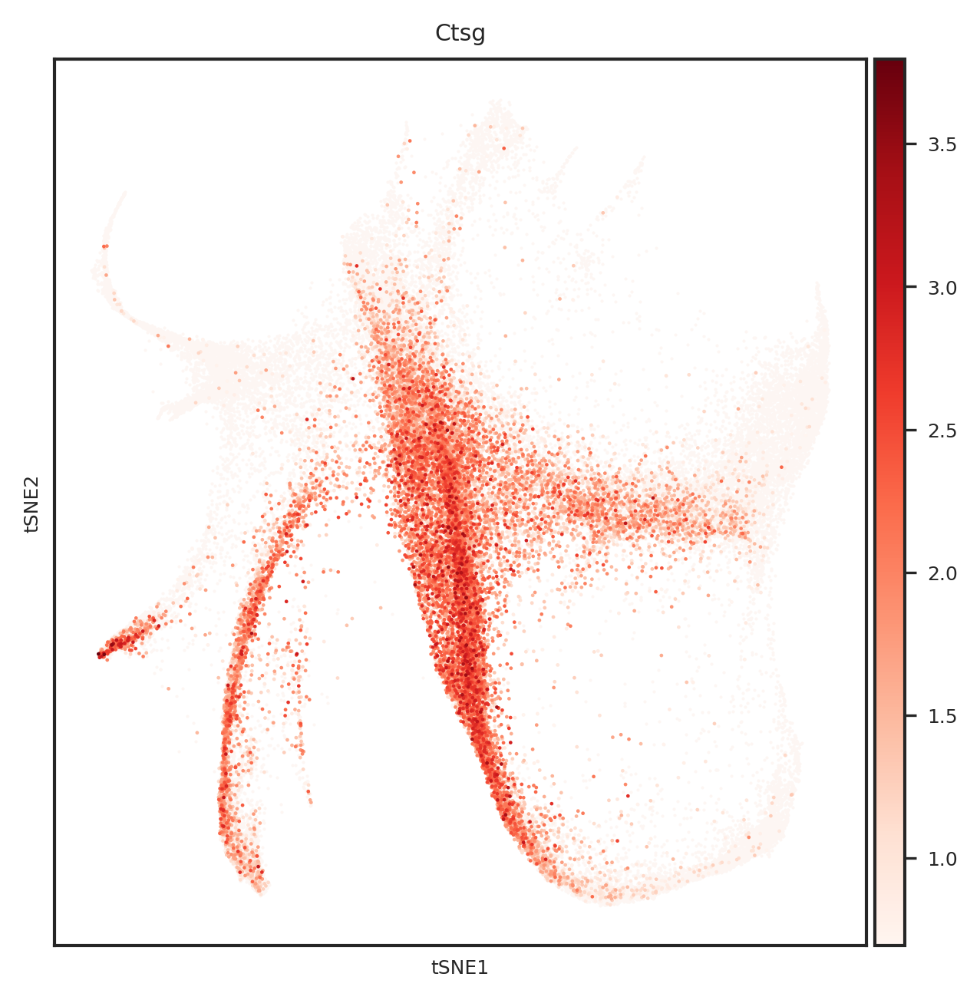

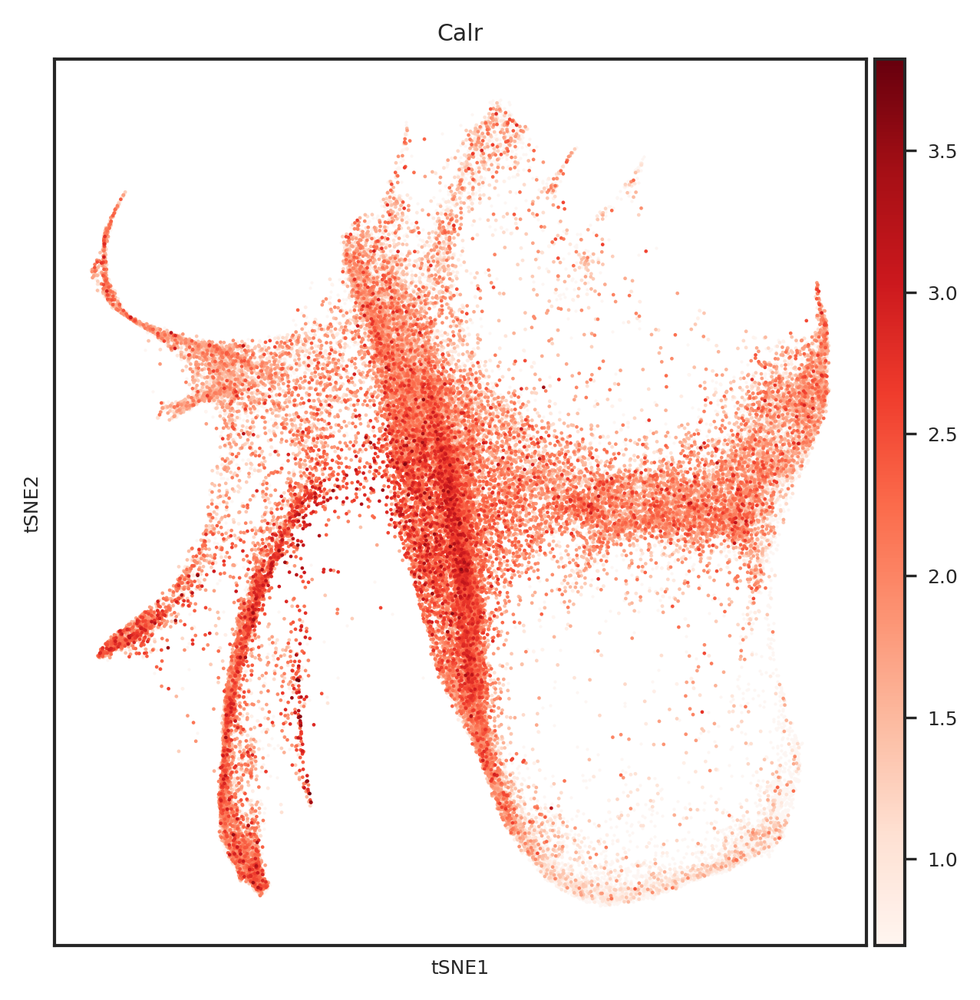

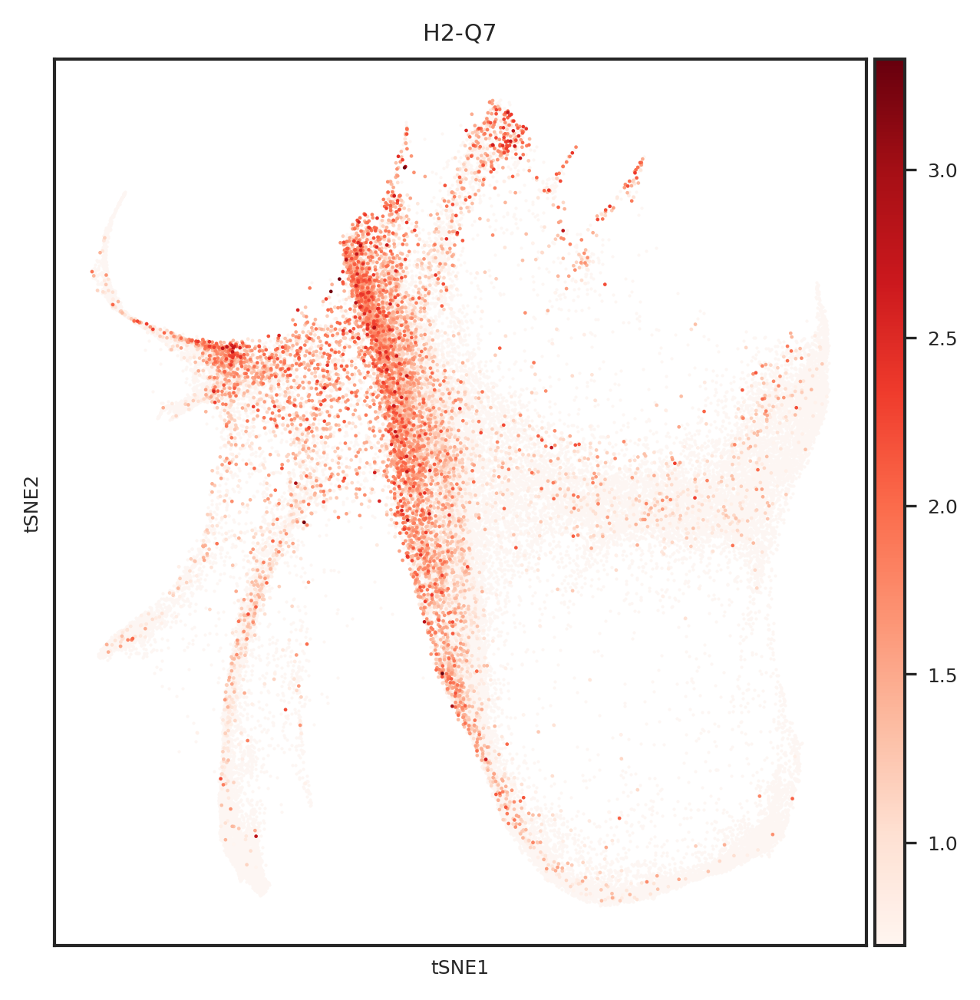

In [865]:
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
#adata.obsm["X_tsne"] = sc.read_h5ad("../1.8_weinreb_forziwei.h5ad").obsm["X_emb_old"]
def create_umap_for_gene(adata, gene_name):
    fig, ax = plt.subplots()
    fig.set_size_inches(5, 5)
    ax.scatter(
        adata.obsm["X_tsne"][:, 0],
        adata.obsm["X_tsne"][:, 1],
        s=1,
        linewidths=0,
        color='#FDF6F3'
    )
    sc.pl.tsne(
        adata[adata.X[:, list(adata.var.index).index(gene_name)] > 0], ax=ax,
        color=gene_name,
        cmap='Reds',
        s=5
    )
    return fig

# 创建一个PDF文件
with PdfPages('top20genes_plots_weinreb_embedding.pdf') as pdf:
    for gene_name in top_genes:
        fig = create_umap_for_gene(adata, gene_name)
        pdf.savefig(fig)  
        plt.close(fig)  


In [110]:
# f_read = open('/home/zhengtuo/songtao/DestinyNet/weinreb_2.22_fate_and_prob/dic_fate_weinreb_ourmodel_allundiff.pkl', 'rb')
# a = pickle.load(f_read)
# adata.obs['fate_pred']=None
# adata.obs['fate_pred']=adata.obs['index'].map(a)
# adata3=adata[adata.obs['fate_pred'].isin([0,1])].copy()
# adata3.obs['fate_pred'] = adata3.obs['fate_pred'].astype('category')
f_read = open('./dic_fate_weinreb_ourmodel_allundiff.pkl', 'rb')
a = pickle.load(f_read)
adata.obs['fate_pred']=None
adata.obs['fate_pred']=adata.obs['index'].map(a)
adata3=adata[adata.obs['fate_pred'].isin([0,1])].copy()
adata3.obs['fate_pred'] = adata3.obs['fate_pred'].astype('category')
sc.tl.rank_genes_groups(adata3, groupby='fate_pred', method='wilcoxon')

In [111]:

# adata3=adata[adata.obs['GT'].isin([0,1])].copy()
# adata3.obs['fate_pred'] = adata3.obs['fate_pred'].astype('category')
# adata3.obs['GT'] = adata3.obs['GT'].astype('category')
# sc.tl.rank_genes_groups(adata3, groupby='GT', method='wilcoxon')
threshold_pval=0.05
def get_marker_genes(adata, label_value, threshold_pval=0.05):
    names_df = pd.DataFrame(adata.uns['rank_genes_groups']['names'])
    logfoldchanges_df = pd.DataFrame(adata.uns['rank_genes_groups']['logfoldchanges'])
    pvals_adj_df = pd.DataFrame(adata.uns['rank_genes_groups']['pvals_adj'])

    return set(names_df[label_value].loc[
        (logfoldchanges_df[label_value] > 1) &
        (pvals_adj_df[label_value] < threshold_pval)
    ])

Mo_marker = get_marker_genes(adata3, '0.0')
Neu_marker = get_marker_genes(adata3, '1.0')
d = Mo_marker.union(Neu_marker)


In [112]:
print(len(Mo_marker))
print(len(Neu_marker))


109
90


In [113]:
import gseapy
adata3.obs['fate_pred']=adata3.obs['fate_pred'].astype('category')
# sc.tl.rank_genes_groups(adata, groupby=groupby, method="wilcoxon", key_added='rank_genes_test',
#                         groups=[1.0], reference=0.0)
# deg_tex = pd.DataFrame(np.hstack([
#     np.array(list(map(list, adata.uns["rank_genes_test"]["names"]))),
#     np.array(list(map(list, adata.uns["rank_genes_test"]['logfoldchanges']))),
#     np.array(list(map(list, adata.uns["rank_genes_test"]['pvals_adj'])))
# ]),
#         columns = list(range(3))
# )
deg_tex_up =Neu_marker
deg_tex_dw =Mo_marker

enr_tex_up = gseapy.enrichr(gene_list=list(deg_tex_up),
                            organism='Mouse',
                            gene_sets='GO_Biological_Process_2021')
enr_tex_dw = gseapy.enrichr(gene_list=list(deg_tex_dw),
                            organism='Mouse',
                            gene_sets='GO_Biological_Process_2021')

# return diff_exp_genes,diff_exp_genes_up,diff_exp_genes_dw,enr_res_up,enr_res_dw
# adata3.obs['fate_pred']=adata3.obs['fate_pred'].astype('category')
# #sc.tl.rank_genes_groups(adata3, groupby='fate_pred', method="wilcoxon", key_added='rank_genes_test',groups=[1.0],reference=0.0)
# deg_tex,deg_tex_up,deg_tex_dw,enr_tex_up,enr_tex_dw = DEG_analysis(adata3, groupby='fate_pred',
#                                                                    query_subtype=1.0, 
#                                                                    reference_subtype=0.0)



/home/zhengtuo/miniconda3/lib/python3.9/site-packages/gseapy/enrichr.py:335: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True, sort=True)
/home/zhengtuo/miniconda3/lib/python3.9/site-packages/gseapy/enrichr.py:335: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  self.results = self.results.append(res, ignore_index=True, sort=True)


In [753]:
len(deg_tex_up)

700

In [754]:
len(deg_tex_dw)

246

In [812]:
enr_tex_up.res2d['Genes'][15]

'HSP90AB1;MS4A3;SLC2A3;PYGL;MPO;HK3;CTSG;CD93;ANXA3;GAA;ATP6AP2;NME2;RHOG;ATP11B;TNFRSF1B;DDOST;VAMP8;EEF1A1;RAB31;PECAM1;PRTN3;PPIA;S100A8;VCL;CD63;CAB39;CLEC12A;FGL2;AGPAT2;PLAC8;ADGRG3;ALOX5;CREG1;NEU1;MLEC;STOM;LTA4H;RAB6A;ELANE;S100A11;VAT1;TMEM30A;IDH1;SURF4;TUBB4B;EEF2;PRDX6;ERP44;IMPDH1;LAMTOR2;YPEL5'

/home/zhengtuo/miniconda3/lib/python3.9/site-packages/gseapy/plot.py:282: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, colname] = df[colname].map(float)


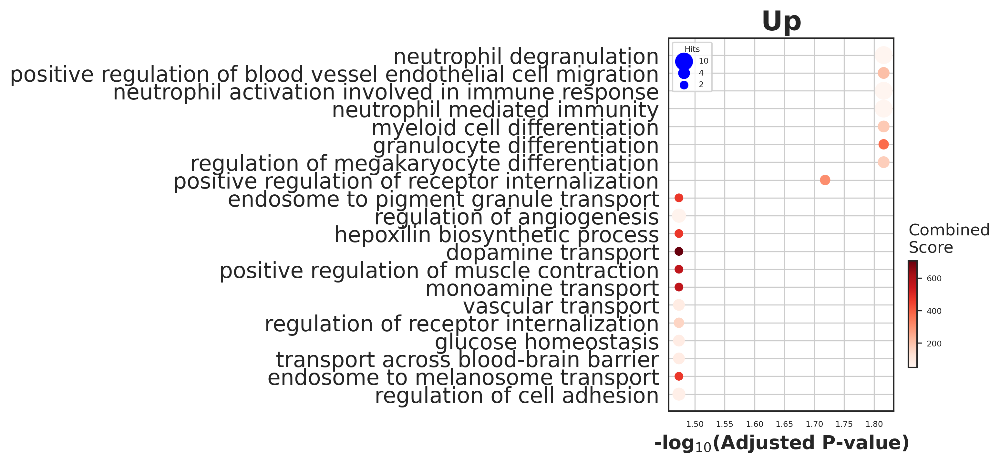

In [115]:

enr_tex_up.res2d.Term = enr_tex_up.res2d.Term.str.split(" \(GO").str[0]
# dotplot
gseapy.dotplot(enr_tex_up.res2d[0:20], size=10, title="Up", 
               top_term=20, 
               cmap='Reds', figsize=(3,5))
fig = plt.gcf()

with PdfPages('./figures/GT_pred_up.pdf') as pdf:
    pdf.savefig(fig, bbox_inches='tight')
plt.show()

In [816]:
genes_1 = set(enr_tex_dw.res2d['Genes'][0].split(","))
genes_2 = set(enr_tex_up.res2d['Genes'][15].split(","))
overlapping_genes = genes_1.intersection(genes_2)
overlapping_genes

set()

/home/zhengtuo/miniconda3/lib/python3.9/site-packages/gseapy/plot.py:282: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, colname] = df[colname].map(float)


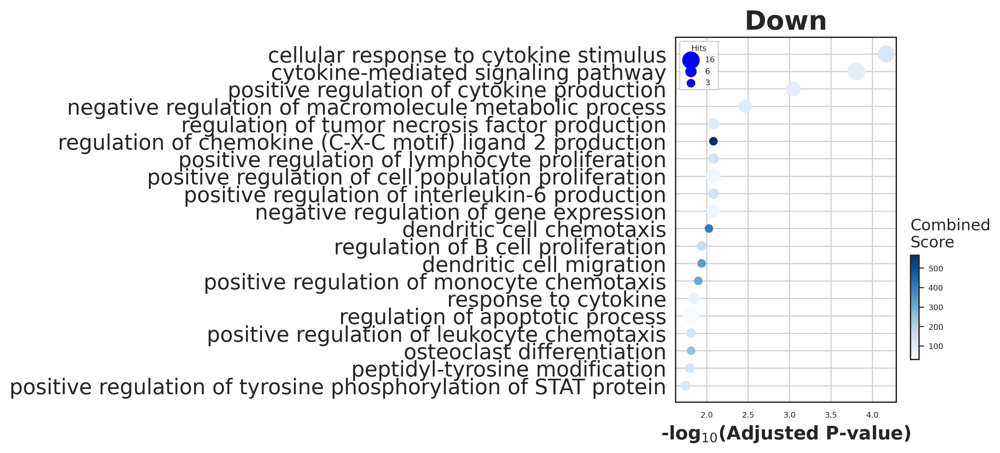

In [116]:
# Figure2C
# trim (go:...)
enr_tex_dw.res2d.Term = enr_tex_dw.res2d.Term.str.split(" \(GO").str[0]
# dotplot
gseapy.dotplot(enr_tex_dw.res2d[0:20], size=12, top_term=20,
               figsize=(3,5), title="Down", cmap='Blues')

fig = plt.gcf()

with PdfPages('./figures/GT_pred_down.pdf') as pdf:
    pdf.savefig(fig, bbox_inches='tight')
plt.show()

In [24]:
gradients_per_label

{0: tensor([7.1293e-09, 6.4681e-08, 3.2634e-08,  ..., 9.6019e-08, 4.2670e-07,
         1.2204e-08], device='cuda:1'),
 1: tensor([9.1898e-09, 5.8025e-08, 2.9834e-08,  ..., 8.4796e-08, 3.7161e-07,
         1.0011e-08], device='cuda:1')}

In [23]:
import seaborn as sns
import pandas as pd
from torch.utils.data import DataLoader, TensorDataset
from torch.autograd import Variable
def compute_gradients_for_label(target_label, data, model_encoder, model_decoder):
    mask = data.obs['fate_pred'] == target_label
    filtered_data = data[mask]
    
    geneex_data = torch.tensor(filtered_data.raw.X.toarray(), dtype=torch.float32).to(device2)
    
    dataset = TensorDataset(geneex_data)
    dataloader = DataLoader(dataset, batch_size=256, shuffle=False)
    
    total_gradients = torch.zeros(len_geneExp).to(device2)
    for batch in dataloader:
        geneExp = batch[0]
        geneExp = Variable(geneExp, requires_grad=True)
        output_data = model_encoder(geneExp)
        output_data = model_decoder(output_data)
        
        loss_function = nn.MSELoss()
        loss = loss_function(output_data, geneExp)
        
        model_encoder.zero_grad()
        model_decoder.zero_grad()
        loss.backward()

        total_gradients += geneExp.grad.abs().mean(dim=0)

    average_gradients = total_gradients / len(dataloader)
    return average_gradients

labels = [0, 1]
gradients_per_label = {}

for label in labels:
    gradients_per_label[label] = compute_gradients_for_label(label, adata, geneEnc, geneDec)


In [29]:
num_key_genes = 30  

key_genes_per_label = {}

for label, gradients in gradients_per_label.items():
    df = pd.DataFrame({
        'gene_ids': adata.var.index.values,
        'importance': gradients.cpu().detach().numpy()
    })

    sorted_df = df.sort_values(by="importance", ascending=False)
    
    key_genes = sorted_df['gene_ids'].head(num_key_genes).tolist()  
    key_genes_per_label[label] = key_genes

# 输出每个标签的关键基因
for label, genes in key_genes_per_label.items():
    print(f"Key genes for label {label}:")
    print(', '.join(genes))
    print("\n")


Key genes for label 0:
mt-Co2, mt-Atp6, mt-Nd1, mt-Co1, Eef1a1, mt-Nd4, Gapdh, mt-Cytb, H2afy, Ppia, Rpl23, Ptma, Tuba1b, Ybx1, Rps23, Actg1, mt-Nd2, Set, Srgn, Rpl12, Rpl4, Actb, Npm1, Pabpc1, Ifitm1, Eif4g2, Rps17, Rpl7, Rps16, Rps24


Key genes for label 1:
mt-Co2, mt-Atp6, mt-Nd1, Eef1a1, mt-Co1, Gapdh, mt-Nd4, mt-Cytb, Srgn, Rpl23, Ppia, Rps23, Ybx1, Actg1, Ptma, H2afy, Rpl12, mt-Nd2, Tuba1b, Rpl4, Npm1, Pabpc1, Rps17, Set, Rps24, Ifitm1, Rpl7, Actb, Rpl27a, Rps16




In [14]:
# adata.obsm['X_pca']=adata.obsm['X_pca'].cpu().numpy()
df_gradients_all['diff'].abs().nlargest(50).index

Index(['Srgn', 'Elane', 'Mpo', 'Ctsg', 'Gstm1', 'Ly6a', 'Calr', 'Prtn3',
       'Fth1', 'H2-Q7', 'Gfi1', 'Ap3s1', 'Igf1r', 'Itm2b', 'Ifi203', 'Cybb',
       'Hk3', 'Spp1', 'Lpl', 'Cd63', 'Psap', 'Muc13', 'Rpl37a', 'Ctsc',
       'Plac8', 'Rps17', 'Anxa3', 'Gas5', 'Rbms1', '2810417H13Rik', 'Tpm4',
       'Ighm', 'Gpx1', 'Rps24', 'Dstn', 'Rpl23', 'Gsr', 'Spint2', 'Thy1',
       'Casp6', 'Lta4h', 'Rpl26', 'Sh3bgrl3', 'Tmbim6', 'Rps23', 'Rpsa',
       'Rpl27a', 'Rps19', 'Cd44', 'Rps10'],
      dtype='object')

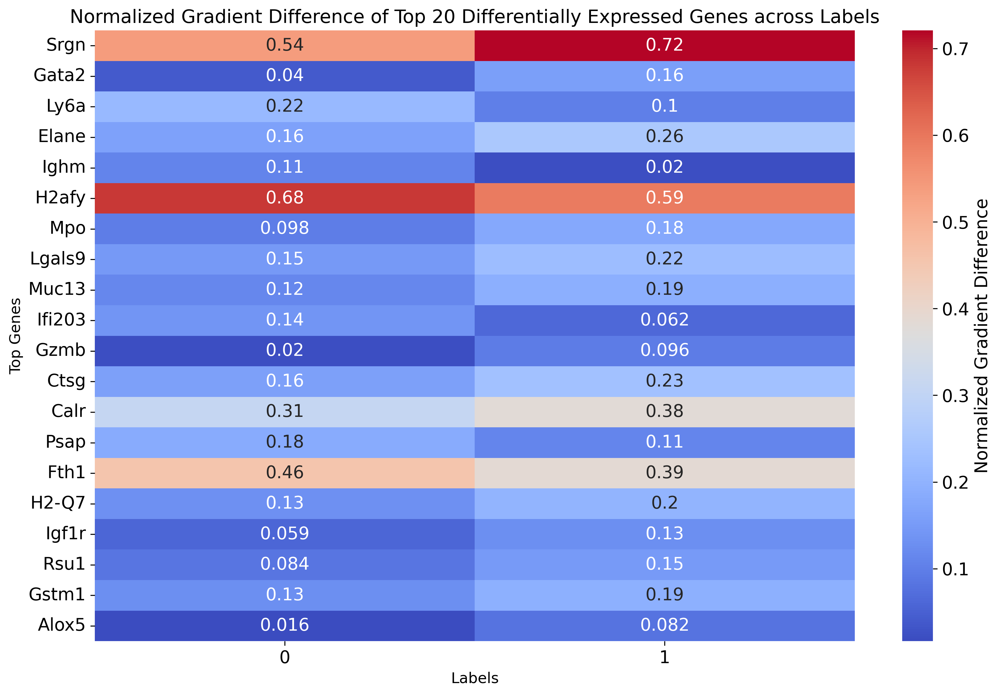

In [86]:
gradient_data = {}
for label, gradients in gradients_per_label.items():
    gradient_data[label] = gradients.cpu().detach().numpy()

# 转为DataFrame
df_gradients_all = pd.DataFrame(gradient_data, index=adata.var.index.values)

def normalize(column):
    """Normalize a pandas column to range between 0 and 1"""
    min_val = column.min()
    max_val = column.max()
    return (column - min_val) / (max_val - min_val)

# Normalize gradients for each label
for label in labels:
    df_gradients_all[label] = normalize(df_gradients_all[label])

# Compute difference between normalized gradients for the two labels
df_gradients_all['diff'] = df_gradients_all[labels[0]] - df_gradients_all[labels[1]]

# Select the top 20 genes with the largest gradient difference
top_genes = df_gradients_all['diff'].abs().nlargest(20).index

# Extract the normalized gradient values for the top genes
df_gradient_top = df_gradients_all.loc[top_genes, labels]

# Plot heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(df_gradient_top, cmap="coolwarm", annot=True, cbar_kws={'label': 'Normalized Gradient Difference'})
plt.title("Normalized Gradient Difference of Top 20 Differentially Expressed Genes across Labels", fontsize=15)
plt.ylabel('Top Genes', fontsize=12)
plt.xlabel('Labels', fontsize=12)
plt.tight_layout()
plt.show()

In [85]:
df_gradient_top
# df_gradient_top.to_csv('./weinreb_top50.csv')


,0,1
Srgn,0.540197,0.720850
Gata2,0.040284,0.158828
Ly6a,0.215512,0.101576
Elane,0.163360,0.255346
Ighm,0.109224,0.020179
H2afy,0.681413,0.593418
Mpo,0.097797,0.176222
Lgals9,0.146582,0.223989
Muc13,0.115342,0.191869
Ifi203,0.138005,0.061555


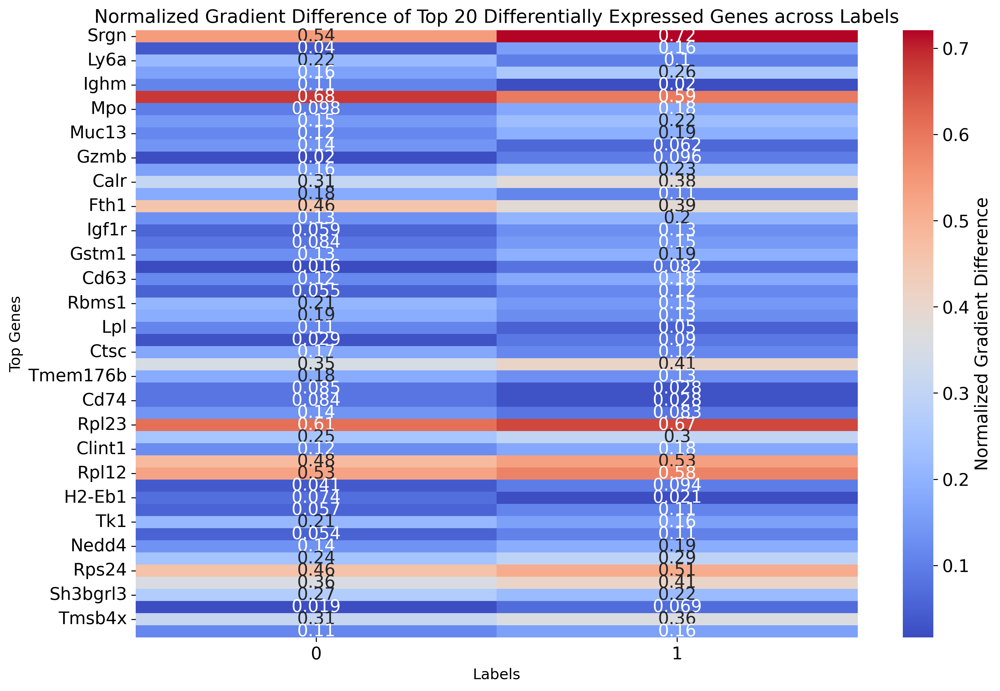

In [42]:

gradient_data = {}
for label, gradients in gradients_per_label.items():
    gradient_data[label] = gradients.cpu().detach().numpy()

df_gradients_all = pd.DataFrame(gradient_data, index=adata.var.index.values)

def normalize(column):
    """Normalize a pandas column to range between 0 and 1"""
    min_val = column.min()
    max_val = column.max()
    return (column - min_val) / (max_val - min_val)

# Normalize gradients for each label
for label in labels:
    df_gradients_all[label] = normalize(df_gradients_all[label])

# Compute difference between normalized gradients for the two labels
df_gradients_all['diff'] = df_gradients_all[labels[0]] - df_gradients_all[labels[1]]

# Select the top 20 genes with the largest gradient difference
top_genes = df_gradients_all['diff'].abs().nlargest(50).index

# Extract the normalized gradient values for the top genes
df_gradient_top = df_gradients_all.loc[top_genes, labels]

# Plot heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(df_gradient_top, cmap="coolwarm", annot=True, cbar_kws={'label': 'Normalized Gradient Difference'})
plt.title("Normalized Gradient Difference of Top 20 Differentially Expressed Genes across Labels", fontsize=15)
plt.ylabel('Top Genes', fontsize=12)
plt.xlabel('Labels', fontsize=12)
plt.tight_layout()
plt.show()




In [76]:
top_genes_bias

,0,1,diff,bias
Ctsc,-0.173801,0.115267,0.058534,-0.058534
Lpl,-0.111949,0.050364,0.061585,-0.061585
Nfkbia,-0.188631,0.126453,0.062178,-0.062178
Rbms1,-0.207719,0.145031,0.062688,-0.062688
Fth1,-0.456394,0.385800,0.070594,-0.070594
Psap,-0.183319,0.112002,0.071317,-0.071317
Ifi203,-0.138005,0.061555,0.076451,-0.076451
H2afy,-0.681413,0.593418,0.087995,-0.087995
Ighm,-0.109224,0.020179,0.089045,-0.089045
Ly6a,-0.215512,0.101576,0.113935,-0.113935


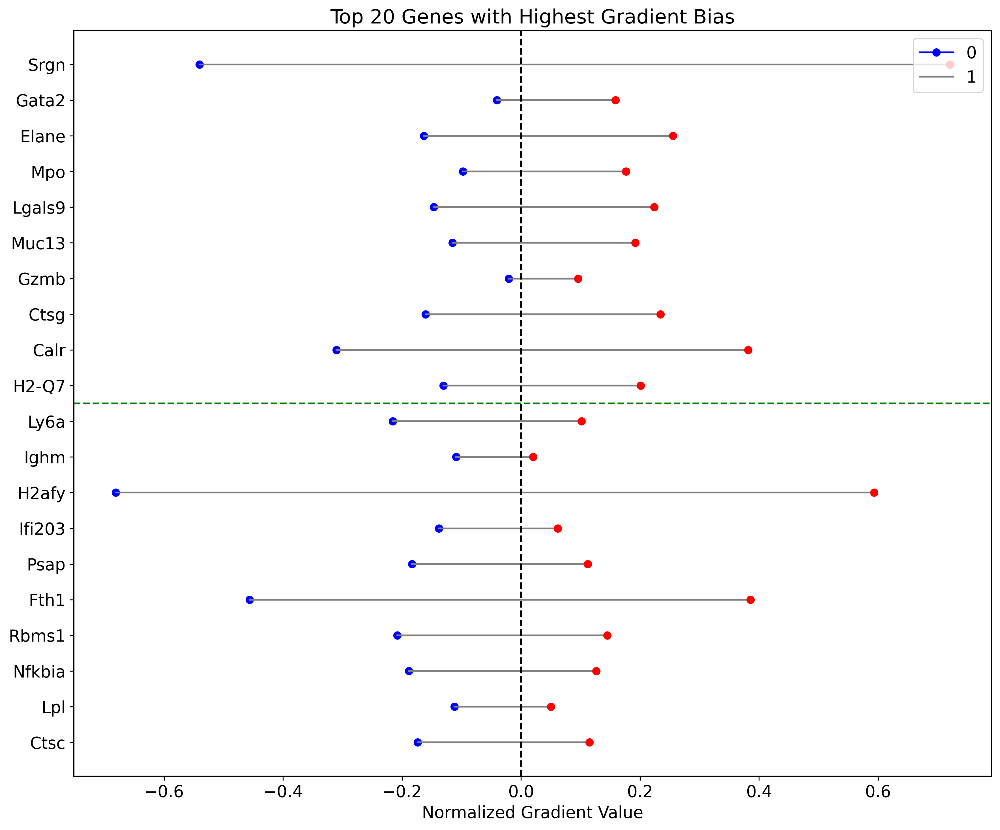

In [35]:
import matplotlib.pyplot as plt
df_gradients_all_normalized = df_gradients_all.copy()
# for label in labels:
#     df_gradients_all_normalized[label] = (df_gradients_all[label] - df_gradients_all[label].min()) / (df_gradients_all[label].max() - df_gradients_all[label].min())


df_gradients_all_normalized[labels[0]] = -df_gradients_all_normalized[labels[0]]

df_gradients_all_normalized['bias'] = df_gradients_all_normalized[labels[1]] + df_gradients_all_normalized[labels[0]]

sorted_df_right_bias = df_gradients_all_normalized.sort_values(by='bias', ascending=False).head(10)
sorted_df_right_bias =sorted_df_right_bias.sort_values(by='bias', ascending=True)

sorted_df_left_bias = df_gradients_all_normalized.sort_values(by='bias').head(10)
sorted_df_left_bias =sorted_df_left_bias.sort_values(by='bias', ascending=False)
top_genes_bias = pd.concat([sorted_df_left_bias, sorted_df_right_bias])
#top_genes_bias = top_genes_bias.sort_values(by='bias', key=abs, ascending=False)

fig, ax = plt.subplots(figsize=(12, 10))


colors = ['blue', 'red']

for gene in top_genes_bias.index:
    for i, label in enumerate(labels):
        x_value = top_genes_bias.loc[gene, label]
        y_value = list(top_genes_bias.index).index(gene)
        ax.plot(x_value, y_value, marker='o', color=colors[i])
        if i == 0:
            x_values = [top_genes_bias.loc[gene, labels[0]], top_genes_bias.loc[gene, labels[1]]]
            y_values = [y_value, y_value]
            ax.plot(x_values, y_values, linestyle='-', color='grey')

ax.axvline(0, color='black', linestyle='--')

divider_position = 10
ax.axhline(divider_position - 0.5, color='green', linestyle='--')

ax.set_yticks(range(len(top_genes_bias.index)))
ax.set_yticklabels(top_genes_bias.index)
ax.set_title('Top 20 Genes with Highest Gradient Bias')
ax.set_xlabel('Normalized Gradient Value')
ax.legend(labels, loc='upper right')

plt.tight_layout()
plt.show()
fig.savefig("/home/zhengtuo/songtao/weinreb_lolipop_plot.pdf", dpi=1000)

In [66]:
top_genes_bias1 = top_genes_bias.sort_values(by='bias', key=abs, ascending=False)
top_genes_bias1.index

Index(['Srgn', 'Elane', 'Mpo', 'Ctsg', 'Gstm1', 'Ly6a', 'Calr', 'Prtn3',
       'Fth1', 'H2-Q7', 'Gfi1', 'Ap3s1', 'Ifi203', 'Cybb', 'Spp1', 'Lpl',
       'Psap', 'Ctsc', 'Rbms1', '2810417H13Rik'],
      dtype='object')

In [71]:
top_genes_bias1 = top_genes_bias.sort_values(by='bias', key=abs, ascending=False)
top_genes_bias1.index

Index(['Srgn', 'Gata2', 'Ly6a', 'Elane', 'Ighm', 'H2afy', 'Mpo', 'Lgals9',
       'Muc13', 'Ifi203', 'Gzmb', 'Ctsg', 'Calr', 'Psap', 'Fth1', 'H2-Q7',
       'Rbms1', 'Nfkbia', 'Lpl', 'Ctsc'],
      dtype='object')

100%|██████████████████████████████████████| 5864/5864 [00:41<00:00, 140.11it/s]


Data saved at adata.uns['clonal_fate_bias']


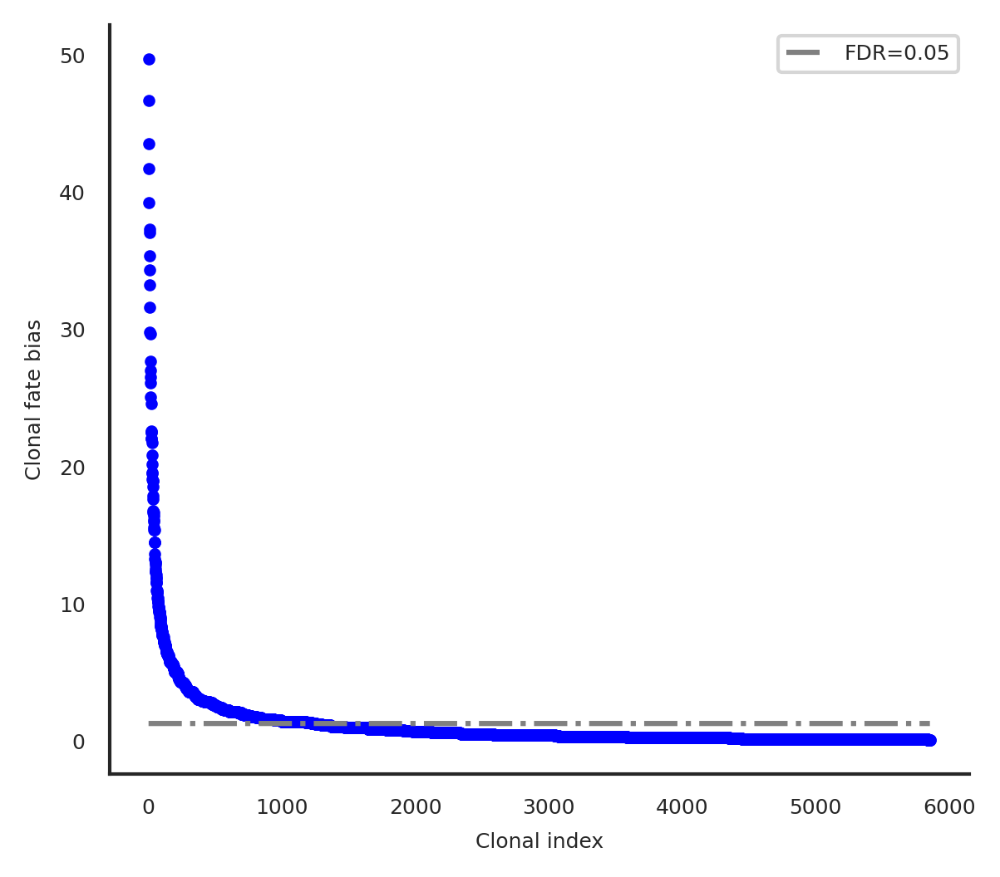

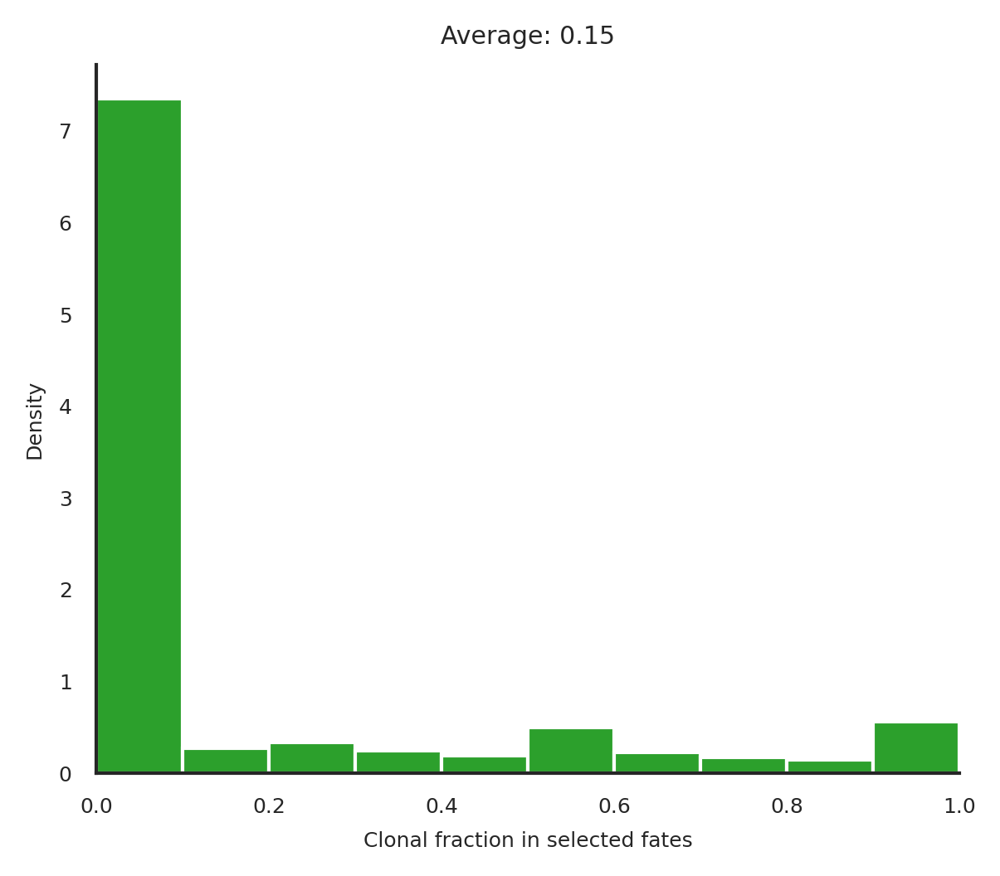

In [881]:
cs.tl.clonal_fate_bias(
    adata, selected_fate="Neutrophil", alternative="two-sided"
)
cs.pl.clonal_fate_bias(adata)

In [347]:
from matplotlib.colors import LinearSegmentedColormap
colors = [(1, 0, 0), (1, 1, 1), (0, 0, 1)]  # R -> W -> B
n_bins = 100
cmap_name = 'custom_div_cmap'
cm = LinearSegmentedColormap.from_list(cmap_name, colors, N=n_bins)

/home/zhengtuo/miniconda3/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


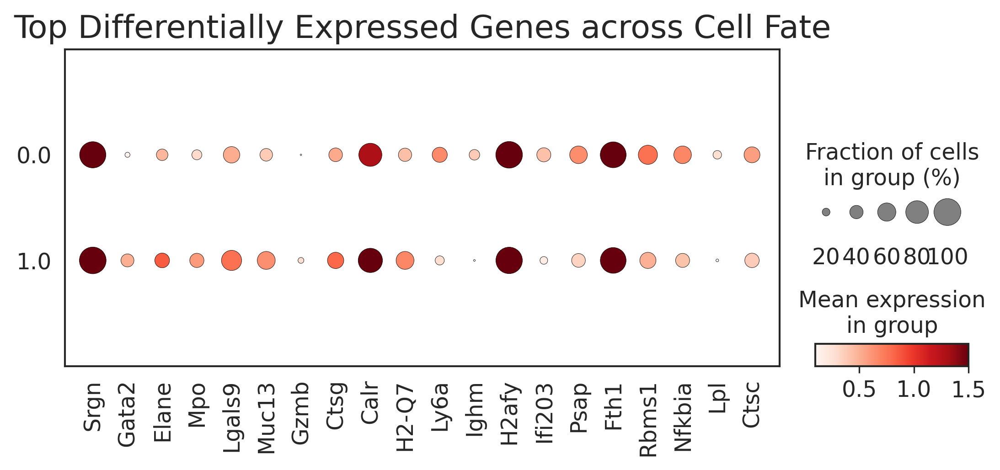

In [77]:

import anndata
# df_expression_all['diff'] = df_expression_all[labels[0]] - df_expression_all[labels[1]]
adata.obs['fate_pred']=adata.obs['fate_pred'].astype('category')
top_genes =  top_genes_bias[::-1].index

adata_raw = anndata.AnnData(X=adata.raw.X, var=adata.raw.var, obs=adata.obs)

sc.pl.dotplot(adata_raw, 
              var_names=top_genes, 
              groupby='fate_pred', 
              figsize=(8.5, 3), 
              dot_max=1, 
              dot_min=0.01, 
              color_map='Reds',
              title="Top Differentially Expressed Genes across Cell Fate",
              vmin=0.1,
              vmax=1.5,
              save='weinreb_dotplot.pdf')


/home/zhengtuo/miniconda3/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


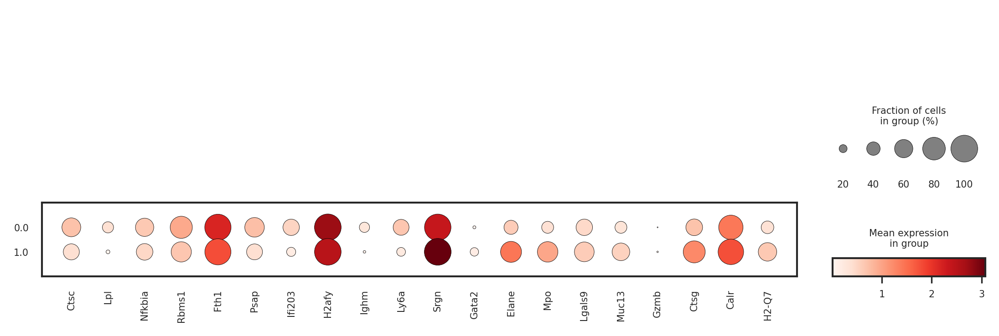

In [501]:
sc.pl.dotplot(adata_raw, 
            var_names=top_genes, 
              groupby='fate_pred',
              
            )

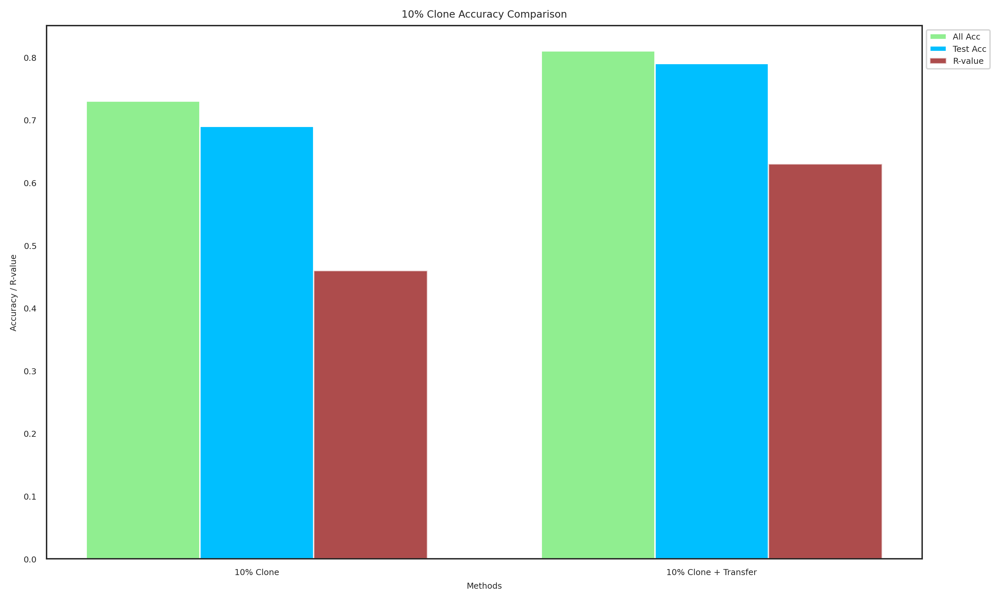

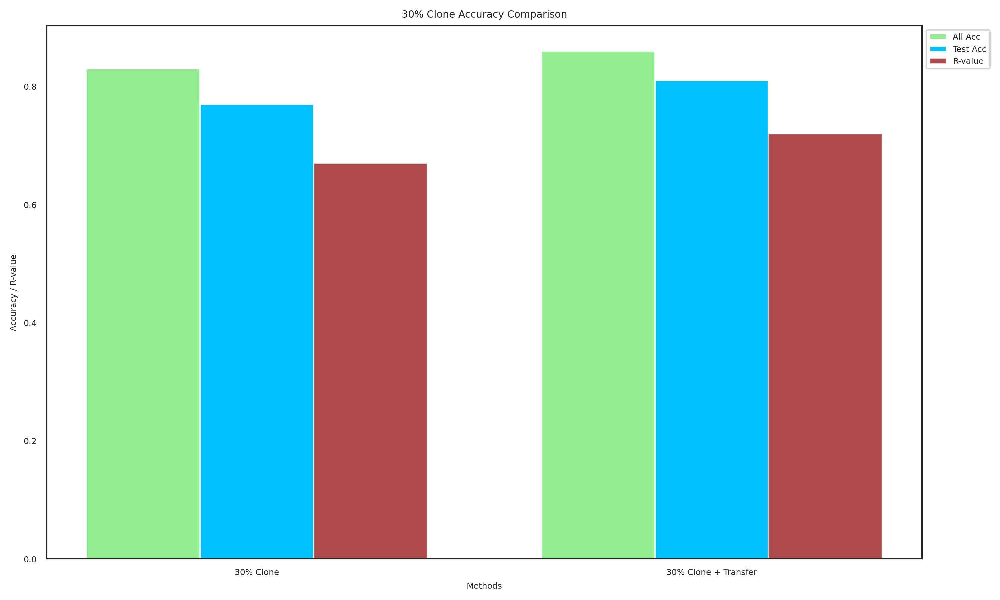

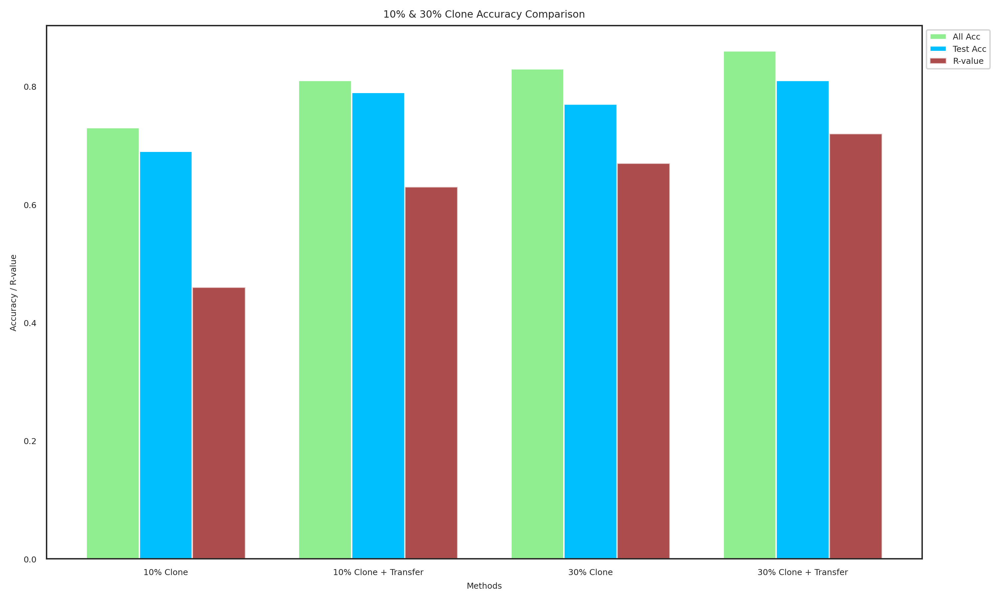

In [140]:
import matplotlib.pyplot as plt

methods_10 = ["10% Clone", "10% Clone + Transfer"]
all_acc_10 = [0.73, 0.81]
test_acc_10 = [0.69, 0.79]
R_values_10 = [0.46, 0.63]

methods_30 = ["30% Clone", "30% Clone + Transfer"]
all_acc_30 = [0.83, 0.86]
test_acc_30 = [0.77, 0.81]
R_values_30 = [0.67, 0.72]

methods_combined = methods_10 + methods_30
all_acc_combined = all_acc_10 + all_acc_30
test_acc_combined = test_acc_10 + test_acc_30
R_values_combined = R_values_10 + R_values_30

bar_width = 0.25
colors = ['deepskyblue', 'lightgreen', 'darkred']

# ... [rest of the code remains unchanged]

def plot_data(methods, all_acc, test_acc, R_values, title, filename):
    fig, ax = plt.subplots(figsize=(10, 6))
    index = range(len(methods))
    bar1 = ax.bar(index, all_acc, bar_width, label='All Acc', color=colors[1])
    bar2 = ax.bar([i+bar_width for i in index], test_acc, bar_width, label='Test Acc', color=colors[0])
    bar3 = ax.bar([i+2*bar_width for i in index], R_values, bar_width, label='R-value', color=colors[2], alpha=0.7)
    
    ax.set_title(title)
    ax.set_xlabel('Methods')
    ax.set_ylabel('Accuracy / R-value')
    ax.set_xticks([i + bar_width for i in index])
    ax.set_xticklabels(methods)
    ax.legend(loc='upper left', bbox_to_anchor=(1, 1))  
    plt.tight_layout()
    
    plt.savefig(filename, dpi=1000)

plot_data(methods_10, all_acc_10, test_acc_10, R_values_10, "10% Clone Accuracy Comparison", "10_clone_accuracy.pdf")
plot_data(methods_30, all_acc_30, test_acc_30, R_values_30, "30% Clone Accuracy Comparison", "30_clone_accuracy.pdf")
plot_data(methods_combined, all_acc_combined, test_acc_combined, R_values_combined, "10% & 30% Clone Accuracy Comparison", "combined_clone_accuracy.pdf")


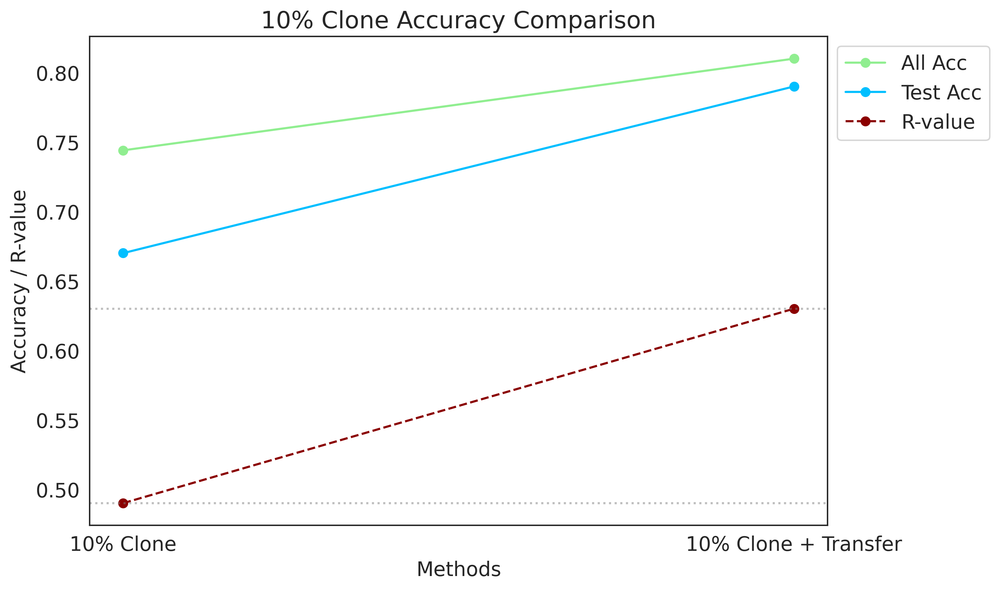

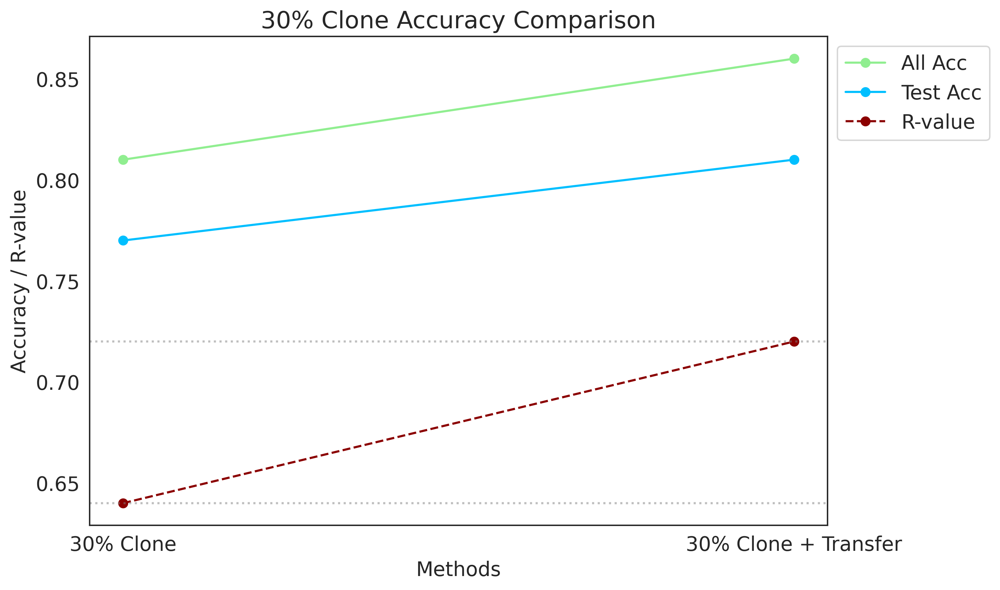

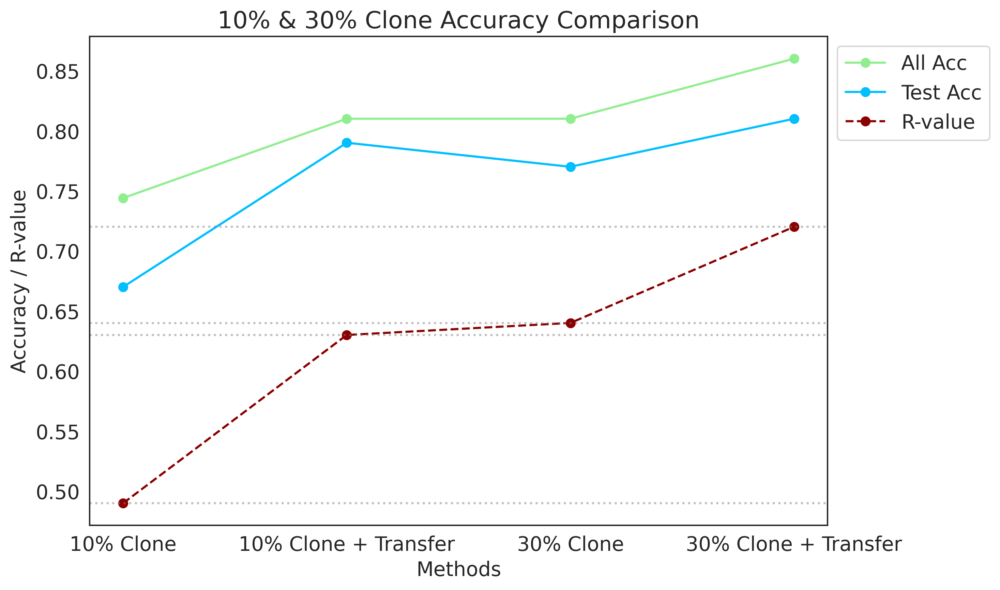

In [116]:
import matplotlib.pyplot as plt

methods_10 = ["10% Clone", "10% Clone + Transfer"]
all_acc_10 = [0.744, 0.81]
test_acc_10 = [0.67, 0.79]
R_values_10 = [0.49, 0.63]

methods_30 = ["30% Clone", "30% Clone + Transfer"]
all_acc_30 = [0.81, 0.86]
test_acc_30 = [0.77, 0.81]
R_values_30 = [0.64, 0.72]

methods_combined = methods_10 + methods_30
all_acc_combined = all_acc_10 + all_acc_30
test_acc_combined = test_acc_10 + test_acc_30
R_values_combined = R_values_10 + R_values_30

colors = ['deepskyblue', 'lightgreen', 'darkred']

def plot_data(methods, all_acc, test_acc, R_values, title):
    fig, ax = plt.subplots(figsize=(10, 6))
    index = range(len(methods))
    line1, = ax.plot(index, all_acc, marker='o', color=colors[1], label='All Acc')
    line2, = ax.plot(index, test_acc, marker='o', color=colors[0], label='Test Acc')
    line3, = ax.plot(index, R_values, marker='o', color=colors[2], label='R-value', linestyle='--')
    
    for r in R_values:
        ax.axhline(r, linestyle=':', color='gray', alpha=0.5)
    
    ax.set_title(title)
    ax.set_xlabel('Methods')
    ax.set_ylabel('Accuracy / R-value')
    ax.set_xticks(index)
    ax.set_xticklabels(methods)
    ax.legend(loc='upper left', bbox_to_anchor=(1, 1))  
    plt.tight_layout()
    plt.show()

plot_data(methods_10, all_acc_10, test_acc_10, R_values_10, "10% Clone Accuracy Comparison")
plot_data(methods_30, all_acc_30, test_acc_30, R_values_30, "30% Clone Accuracy Comparison")
plot_data(methods_combined, all_acc_combined, test_acc_combined, R_values_combined, "10% & 30% Clone Accuracy Comparison")
